# An overall usage of scikit-learn (and others) regression options

In [96]:
import pandas as pd
import matplotlib.pyplot as plt

In [97]:
data = pd.read_csv('train.csv')
test_data = pd.read_csv('test.csv')

In [98]:
data.columns

Index(['Id', 'MSSubClass', 'MSZoning', 'LotFrontage', 'LotArea', 'Street',
       'Alley', 'LotShape', 'LandContour', 'Utilities', 'LotConfig',
       'LandSlope', 'Neighborhood', 'Condition1', 'Condition2', 'BldgType',
       'HouseStyle', 'OverallQual', 'OverallCond', 'YearBuilt', 'YearRemodAdd',
       'RoofStyle', 'RoofMatl', 'Exterior1st', 'Exterior2nd', 'MasVnrType',
       'MasVnrArea', 'ExterQual', 'ExterCond', 'Foundation', 'BsmtQual',
       'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinSF1',
       'BsmtFinType2', 'BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF', 'Heating',
       'HeatingQC', 'CentralAir', 'Electrical', '1stFlrSF', '2ndFlrSF',
       'LowQualFinSF', 'GrLivArea', 'BsmtFullBath', 'BsmtHalfBath', 'FullBath',
       'HalfBath', 'BedroomAbvGr', 'KitchenAbvGr', 'KitchenQual',
       'TotRmsAbvGrd', 'Functional', 'Fireplaces', 'FireplaceQu', 'GarageType',
       'GarageYrBlt', 'GarageFinish', 'GarageCars', 'GarageArea', 'GarageQual',
       'GarageCond', 'PavedDrive

In [99]:
data.shape

(1460, 81)

In [100]:
data.head()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2008,WD,Normal,208500
1,2,20,RL,80.0,9600,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,5,2007,WD,Normal,181500
2,3,60,RL,68.0,11250,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,9,2008,WD,Normal,223500
3,4,70,RL,60.0,9550,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2006,WD,Abnorml,140000
4,5,60,RL,84.0,14260,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,12,2008,WD,Normal,250000


### Checking/Plotting missing values

In [101]:
missing_val_count_by_column = (data.isnull().sum())
print(missing_val_count_by_column[missing_val_count_by_column > 0].sort_values(ascending=False))

PoolQC          1453
MiscFeature     1406
Alley           1369
Fence           1179
FireplaceQu      690
LotFrontage      259
GarageYrBlt       81
GarageType        81
GarageFinish      81
GarageQual        81
GarageCond        81
BsmtFinType2      38
BsmtExposure      38
BsmtFinType1      37
BsmtCond          37
BsmtQual          37
MasVnrArea         8
MasVnrType         8
Electrical         1
dtype: int64


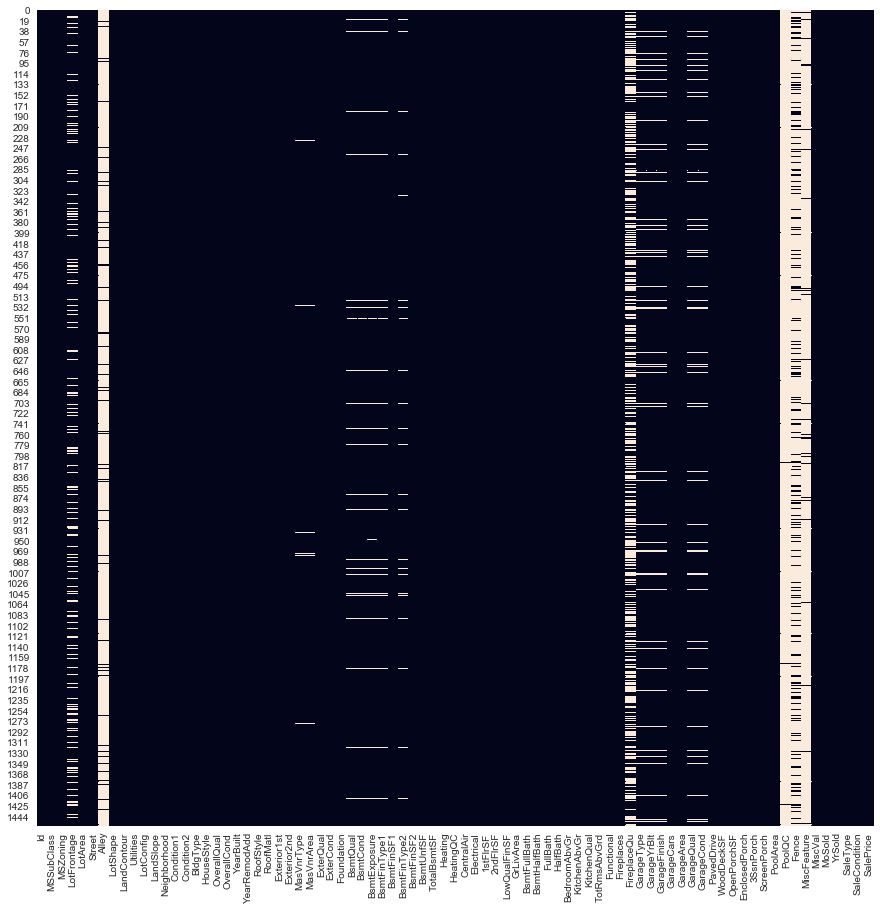

In [102]:
%matplotlib inline
import seaborn as sns
sns.set(rc={'figure.figsize':(15,15)})
sns.heatmap(data.isnull(), cbar=False)

Let's remove Alley, FireplaceQu, PoolQC, Fence, MiscFeature since they have **SO MANY** missing values.

In [103]:
data = data.drop(['Alley', 'FireplaceQu', 'PoolQC', 'Fence', 'MiscFeature'], axis=1)

### Very important, for categorical variable, it doesn't make too much sense to imput data according to median/mode, etc... so, one feasible option is to imput another category (for example, "None") and save the median (or similar) imputation only for the numerical features

Inspired here: https://stackoverflow.com/questions/34913590/fillna-in-multiple-columns-in-place-in-python-pandas
And here: https://www.kaggle.com/miloofcroton/house-prices-regression-using-catboost-2/log

In [104]:
data = data.apply(lambda x: x.fillna('None') if (x.dtype.kind == 'O') else x) # Fill with None the NaN of the Object type
data.head()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,Utilities,LotConfig,...,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,Reg,Lvl,AllPub,Inside,...,0,0,0,0,0,2,2008,WD,Normal,208500
1,2,20,RL,80.0,9600,Pave,Reg,Lvl,AllPub,FR2,...,0,0,0,0,0,5,2007,WD,Normal,181500
2,3,60,RL,68.0,11250,Pave,IR1,Lvl,AllPub,Inside,...,0,0,0,0,0,9,2008,WD,Normal,223500
3,4,70,RL,60.0,9550,Pave,IR1,Lvl,AllPub,Corner,...,272,0,0,0,0,2,2006,WD,Abnorml,140000
4,5,60,RL,84.0,14260,Pave,IR1,Lvl,AllPub,FR2,...,0,0,0,0,0,12,2008,WD,Normal,250000


In [107]:
# drop by Name
X = data.drop(['Id', 'SalePrice'], axis=1)
y = data['SalePrice']

In [108]:
import numpy as np
# https://www.kaggle.com/dansbecker/using-categorical-data-with-one-hot-encoding
one_hot_encoded_training_predictors = pd.get_dummies(X, dtype=np.float)

In [109]:
# help(pd.get_dummies)

In [110]:
X.shape

(1460, 74)

In [111]:
one_hot_encoded_training_predictors.shape

(1460, 280)

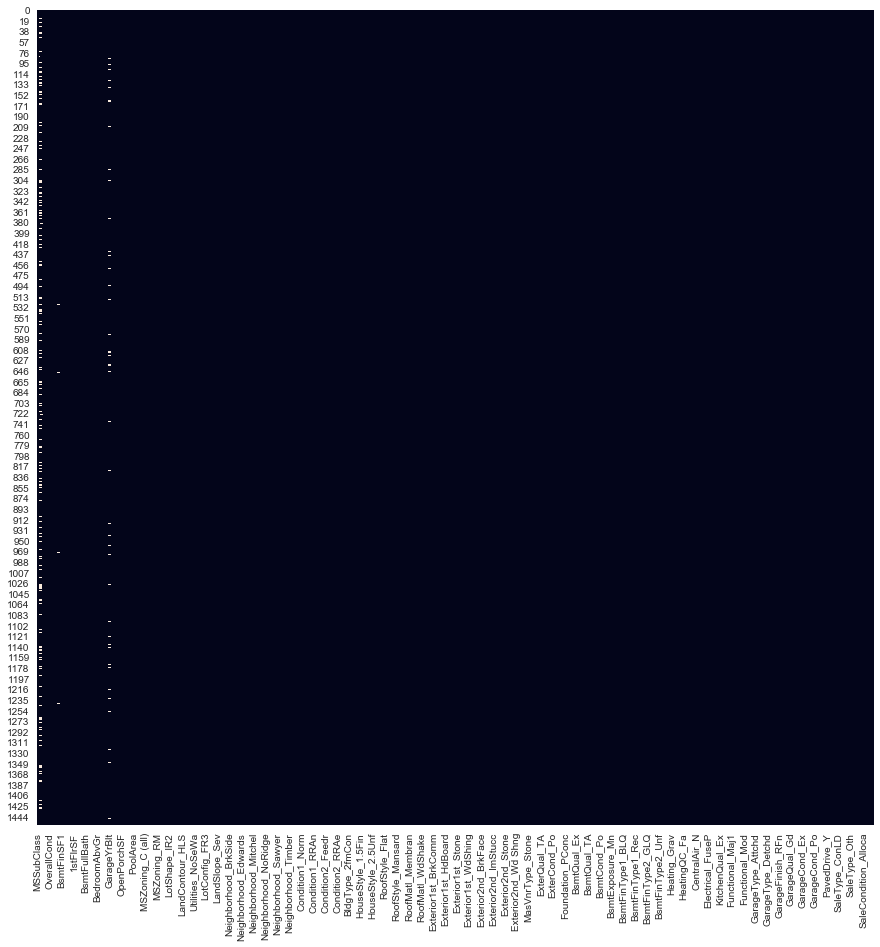

In [112]:
sns.heatmap(one_hot_encoded_training_predictors.isnull(), cbar=False)

Let's input the missing values of the ones who is left.

In [113]:
# https://scikit-learn.org/stable/modules/impute.html#impute
from sklearn.preprocessing import Imputer

**Note that it is np.nan in the missing values!**

An example of imputing and returning as a pandas DataFrame (instead of a numpy array) can be found here: https://stackoverflow.com/questions/33660836/impute-entire-dataframe-all-columns-using-scikit-learn-sklearn-without-itera

In [114]:
imp = Imputer(missing_values = np.nan, strategy = 'median', axis = 0)
imp.fit(one_hot_encoded_training_predictors)
X = imp.transform(one_hot_encoded_training_predictors)

C:\Users\renan\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\utils\deprecation.py:58: DeprecationWarning: Class Imputer is deprecated; Imputer was deprecated in version 0.20 and will be removed in 0.22. Import impute.SimpleImputer from sklearn instead.
  warnings.warn(msg, category=DeprecationWarning)


In [115]:
X.shape

(1460, 280)

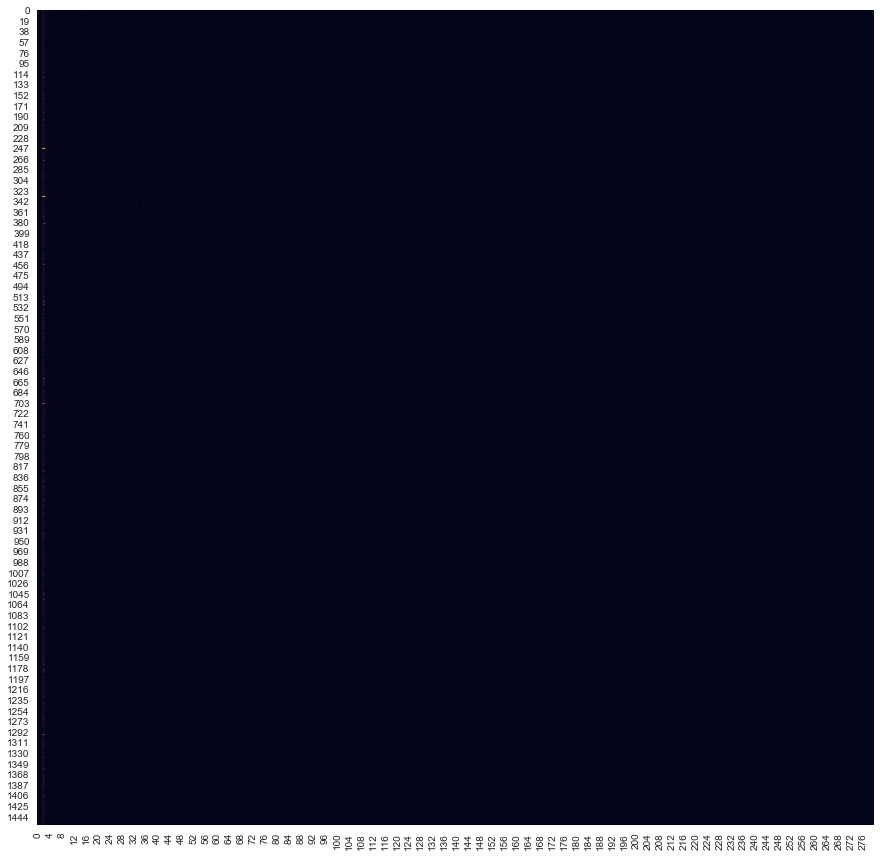

In [116]:
sns.heatmap(X, cbar=False)

### Very basic linear regression

In [117]:
from sklearn import linear_model
reg_all = linear_model.LinearRegression()

In [118]:
reg_all.fit(X, y)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None,
         normalize=False)

But, this is not ML... this is statistics... Let's brake the data to start the "ML":

In [119]:
from sklearn.model_selection import train_test_split

In [120]:
X_train, X_valid, y_train, y_valid = train_test_split(X, y, test_size = 0.3, random_state = 235423)

In [121]:
reg = linear_model.LinearRegression()
reg.fit(X_train, y_train)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None,
         normalize=False)

In [122]:
y_true, y_pred = y_valid, reg.predict(X_valid)

In [123]:
np.sqrt(np.mean((y_true - y_pred) ** 2)) # RMSE

25602.158656618078

In [124]:
reg.score(X_valid, y_valid) # R^2 (can be negative depending on how awful is your model to predict test)

0.8835527264758691

This is not enough... you need to do Cross-Validation:

In [125]:
from sklearn.model_selection import cross_val_score

In [126]:
reg = linear_model.LinearRegression()
cv_results = cross_val_score(reg, X, y, cv = 5)

In [127]:
cv_results

array([ 8.50332693e-01,  8.21076241e-01,  8.12055621e-01, -1.25081198e+10,
        6.68784178e-01])

### Regularized regressions: Ridge and Lasso

We have **so many** features in the data, let's perfoemd a regularized regression (Ridge or Lasso)

Ridge: the term penalty is the square of coefficients (L2)

Lasso: the term penalty is the absolute value of coefficients (L1) (SHRINKS the magnitude of the coefficient to zero)

In [128]:
from sklearn.linear_model import Ridge
ridge = Ridge(alpha = 0.1, normalize = True) # If normalize True, the regressors X will be normalized before regression by subtracting the mean and dividing by the l2-norm.
ridge.fit(X_train, y_train)

Ridge(alpha=0.1, copy_X=True, fit_intercept=True, max_iter=None,
   normalize=True, random_state=None, solver='auto', tol=0.001)

In [129]:
from sklearn.linear_model import Lasso
lasso = Lasso(alpha = 0.1)
lasso.fit(X_train, y_train)

C:\Users\renan\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\linear_model\coordinate_descent.py:492: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Lasso(alpha=0.1, copy_X=True, fit_intercept=True, max_iter=1000,
   normalize=False, positive=False, precompute=False, random_state=None,
   selection='cyclic', tol=0.0001, warm_start=False)

In [130]:
lasso_coef = lasso.coef_

In [131]:
lasso_coef.min()

-653323.9957600401

In [132]:
feature_names = one_hot_encoded_training_predictors.columns

Observe that the coefficients for the Lasso regression are shrinkaged towards zero to highlight to most important ones.

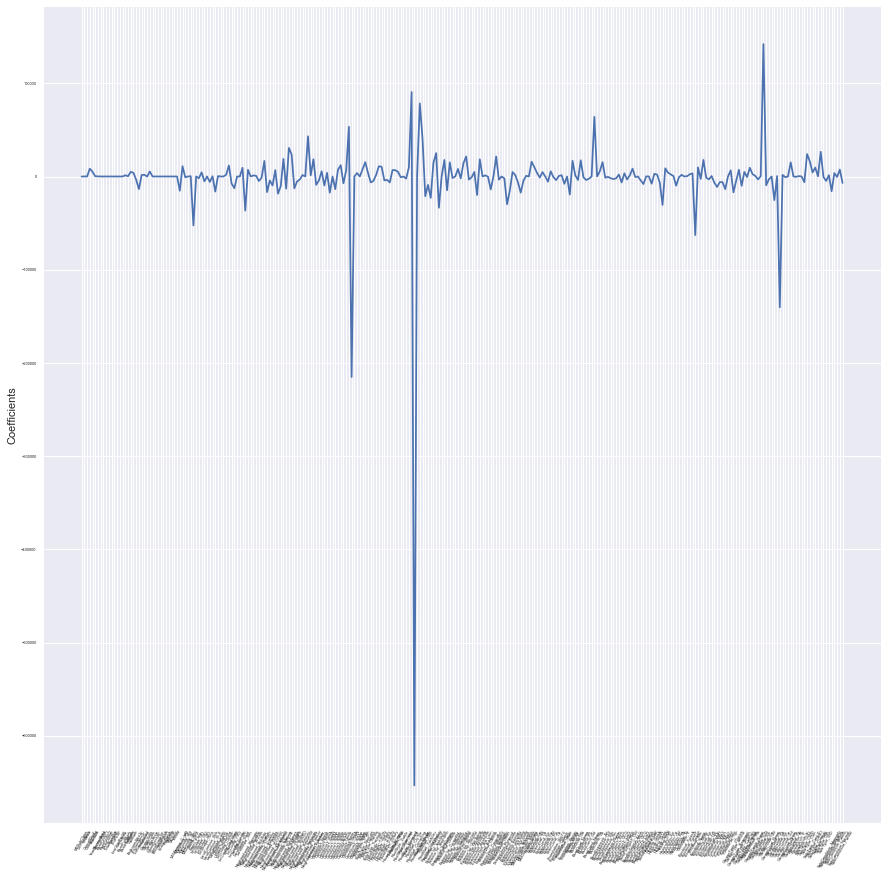

In [133]:
sns.set(rc={'figure.figsize':(15,15)})
_ = plt.plot(range(len(feature_names)), lasso_coef)
_ = plt.xticks(range(len(feature_names)), feature_names, rotation = 60)
_ = plt.ylabel('Coefficients')
_ = plt.tick_params(axis='both', labelsize = 4) # Label size of the tickmarks

**Note that the coefficients of the Lasso regression are not very sensitive to the alpha parameter!**

In [134]:
lasso = Lasso(alpha = 0.9)
lasso.fit(X_train, y_train)
lasso_coef = lasso.coef_

C:\Users\renan\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\linear_model\coordinate_descent.py:492: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


In [135]:
lasso_coef.min()

-650605.0852000761

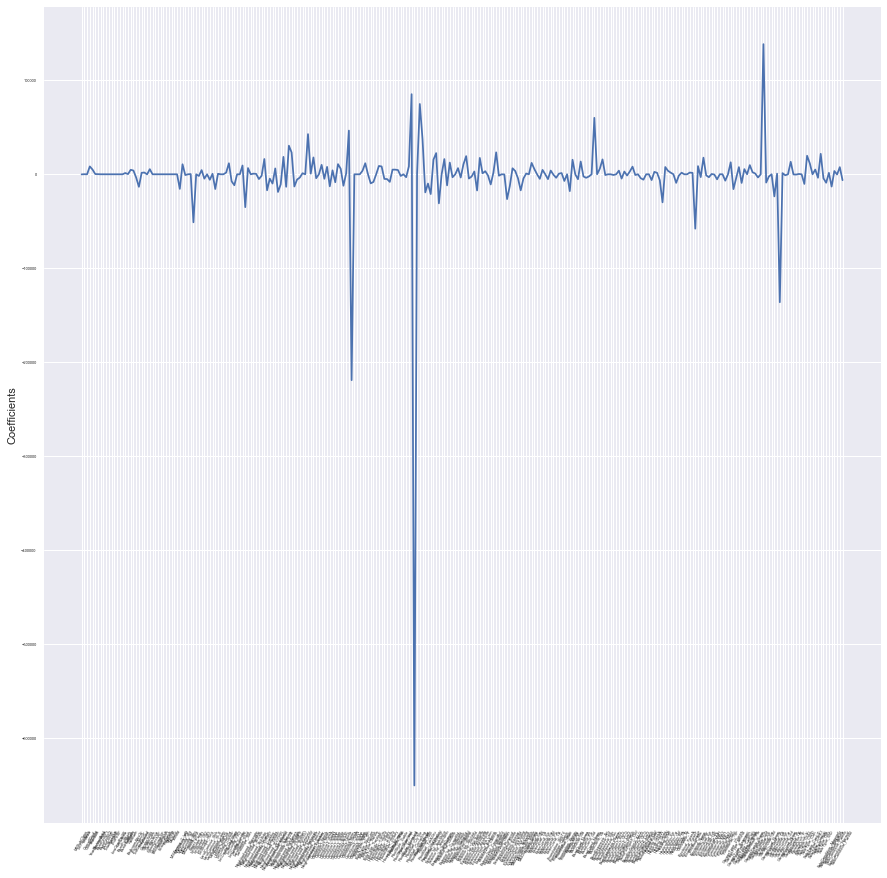

In [136]:
sns.set(rc={'figure.figsize':(15,15)})
_ = plt.plot(range(len(feature_names)), lasso_coef)
_ = plt.xticks(range(len(feature_names)), feature_names, rotation = 60)
_ = plt.ylabel('Coefficients')
_ = plt.tick_params(axis='both', labelsize = 4) # Label size of the tickmarks

### Hyperparameter Tuning

However, let's try to tune this alpha for the Ridge and Lasso with some hyperparameter tuning.

In [137]:
from sklearn.model_selection import GridSearchCV
param_grid = {'alpha' : np.arange(0.05, 1, 0.05)}

# Another option (not used)
#param_grid = {'alpha' : [0.05, 0.1, 0.3, 1, 3, 5, 10, 15, 30, 50, 75]}


Ridge Tuning (using MAE as metric):

In [138]:
ridge = Ridge(normalize = True)
ridge_cv = GridSearchCV(ridge, param_grid, cv = 5, verbose = 1, scoring='neg_mean_absolute_error', n_jobs = -1)
#ridge_cv = GridSearchCV(ridge, param_grid, cv = 5, verbose = 1, scoring='neg_mean_squared_log_error', n_jobs = -1)

# THE INFORMATIVE ERROR FROM KERNEL ON KAGGLE (updaed version of scikit-learn):
# ValueError: Mean Squared Logarithmic Error cannot be used when targets contain negative values.

In [139]:
import sklearn
print('The scikit-learn version is {}.'.format(sklearn.__version__))

The scikit-learn version is 0.20.3.


In [140]:
ridge_cv.fit(X_train, y_train)

Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  26 tasks      | elapsed:    3.0s
[Parallel(n_jobs=-1)]: Done  95 out of  95 | elapsed:    3.4s finished


GridSearchCV(cv=5, error_score='raise-deprecating',
       estimator=Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
   normalize=True, random_state=None, solver='auto', tol=0.001),
       fit_params=None, iid='warn', n_jobs=-1,
       param_grid={'alpha': array([0.05, 0.1 , 0.15, 0.2 , 0.25, 0.3 , 0.35, 0.4 , 0.45, 0.5 , 0.55,
       0.6 , 0.65, 0.7 , 0.75, 0.8 , 0.85, 0.9 , 0.95])},
       pre_dispatch='2*n_jobs', refit=True, return_train_score='warn',
       scoring='neg_mean_absolute_error', verbose=1)

In [141]:
ridge_cv.best_params_

{'alpha': 0.35000000000000003}

Lasso Tuning:

In [142]:
lasso = Lasso(tol = 0.1) # The default tolerance wasn't conveging the algorithm...
lasso_cv = GridSearchCV(lasso, param_grid, cv = 5, verbose = 1, scoring='neg_mean_absolute_error')
#lasso_cv = GridSearchCV(lasso, param_grid, cv = 5, verbose = 1, scoring='neg_mean_squared_log_error')

In [143]:
lasso_cv.fit(X_train, y_train)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.6s finished


GridSearchCV(cv=5, error_score='raise-deprecating',
       estimator=Lasso(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=1000,
   normalize=False, positive=False, precompute=False, random_state=None,
   selection='cyclic', tol=0.1, warm_start=False),
       fit_params=None, iid='warn', n_jobs=None,
       param_grid={'alpha': array([0.05, 0.1 , 0.15, 0.2 , 0.25, 0.3 , 0.35, 0.4 , 0.45, 0.5 , 0.55,
       0.6 , 0.65, 0.7 , 0.75, 0.8 , 0.85, 0.9 , 0.95])},
       pre_dispatch='2*n_jobs', refit=True, return_train_score='warn',
       scoring='neg_mean_absolute_error', verbose=1)

In [144]:
lasso_cv.best_params_

{'alpha': 0.9500000000000001}

In [145]:
lasso_cv.best_score_

-26515.629591359346

Submitiing Ridge, sice it was better than Lasso:

In [146]:
test_data = test_data.drop(['Alley', 'FireplaceQu', 'PoolQC', 'Fence', 'MiscFeature'], axis=1)

In [147]:
test_X = test_data.drop(['Id'], axis=1)

In [148]:
test_one_hot_encoded_training_predictors = pd.get_dummies(test_X, dtype=np.float)

In [149]:
# I had this problem of unmatching columns of train and test after one-hot-encoding: https://stackoverflow.com/questions/41335718/keep-same-dummy-variable-in-training-and-testing-data


# Get missing columns in the training test
missing_cols = set( one_hot_encoded_training_predictors.columns ) - set( test_one_hot_encoded_training_predictors.columns )
# Add a missing column in test set with default value equal to 0
for c in missing_cols:
    test_one_hot_encoded_training_predictors[c] = 0
# Ensure the order of column in the test set is in the same order than in train set
test_one_hot_encoded_training_predictors = test_one_hot_encoded_training_predictors[one_hot_encoded_training_predictors.columns]

In [150]:
imp = Imputer(missing_values = np.nan, strategy = 'median', axis = 0)
imp.fit(test_one_hot_encoded_training_predictors)
test_X = imp.transform(test_one_hot_encoded_training_predictors)

C:\Users\renan\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\utils\deprecation.py:58: DeprecationWarning: Class Imputer is deprecated; Imputer was deprecated in version 0.20 and will be removed in 0.22. Import impute.SimpleImputer from sklearn instead.
  warnings.warn(msg, category=DeprecationWarning)


In [151]:
ridge = Ridge(alpha = list(ridge_cv.best_params_.values())[0], normalize = True)
ridge.fit(X, y)

Ridge(alpha=0.35000000000000003, copy_X=True, fit_intercept=True,
   max_iter=None, normalize=True, random_state=None, solver='auto',
   tol=0.001)

In [61]:
y_pred = ridge.predict(test_X)

In [62]:
final_sub = pd.DataFrame.from_dict({'Id': test_data.Id, 'SalePrice': y_pred})
final_sub.head()

,Id,SalePrice
0,1461,112459.226429
1,1462,156802.893777
2,1463,184611.147379
3,1464,196530.869303
4,1465,201822.786117


In [63]:
final_sub.to_csv('submit_file.csv', sep=',', index = False) # Public Score 0.14073 (The Lasso (omitted in this notebook) was worse: 0.18601)

---

#### So, I figure out that to actually work with a more appropriate metric to check model performace (in Kaggle they work with Root Mean Squared Logarithmic Error) it is to work with **logarithmic** of the price (shrinking the variance, therefore) and working with Root Mean Squared Error (RMSE) (`'neg_mean_squared_error'`). <font color='red'>**Let's work with the logarithmic scale from now on!**</font>

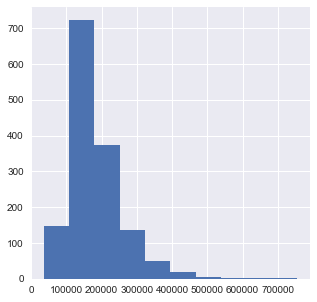

In [64]:
y.hist(figsize = (5, 5))

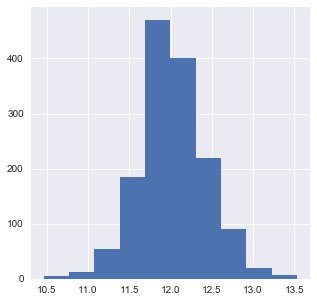

In [65]:
y_log = np.log(y)
y_log.hist(figsize = (5, 5))

In [160]:
X_train, X_valid, y_train, y_valid = train_test_split(X, y_log, test_size = 0.3, random_state = 235423)

In [69]:
param_grid = {'alpha' : np.arange(0.05, 1, 0.05)}
ridge = Ridge(normalize = True)
ridge_cv = GridSearchCV(ridge, param_grid, cv = 5, verbose = 1, scoring='neg_mean_squared_error', n_jobs = -1)
ridge_cv.fit(X_train, y_train)

Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  95 out of  95 | elapsed:    0.2s finished


GridSearchCV(cv=5, error_score='raise-deprecating',
       estimator=Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
   normalize=True, random_state=None, solver='auto', tol=0.001),
       fit_params=None, iid='warn', n_jobs=-1,
       param_grid={'alpha': array([0.05, 0.1 , 0.15, 0.2 , 0.25, 0.3 , 0.35, 0.4 , 0.45, 0.5 , 0.55,
       0.6 , 0.65, 0.7 , 0.75, 0.8 , 0.85, 0.9 , 0.95])},
       pre_dispatch='2*n_jobs', refit=True, return_train_score='warn',
       scoring='neg_mean_squared_error', verbose=1)

In [70]:
ridge_cv.best_score_

-0.02414581749535567

In [71]:
np.sqrt(-1 * ridge_cv.best_score_) # RMSE (the RMSLE of Kaggle)

0.15538924510839117

In [72]:
ridge_cv.best_params_

{'alpha': 0.45}

In [73]:
# "The model is trained on the full development set."
# "The scores are computed on the full evaluation set."
y_true, y_pred = y_valid, ridge_cv.predict(X_valid)

In [66]:
np.sqrt(np.mean((y_true - y_pred) ** 2)) # Estimation of Validation score

0.1173437048470548

In [67]:
y_pred = np.exp(ridge_cv.predict(test_X))

In [68]:
final_sub = pd.DataFrame.from_dict({'Id': test_data.Id, 'SalePrice': y_pred})
final_sub.to_csv('ridge_tuned_logarithmic_scale.csv', sep=',', index = False) # Public Score 0.13785! It improved from the non-logarithmic Ridge! 

Let's train this with Full Data:

In [69]:
ridge = Ridge(normalize = True)
ridge_cv = GridSearchCV(ridge, param_grid, cv = 5, verbose = 1, scoring='neg_mean_squared_error')
ridge_cv.fit(X, y_log)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.9s finished


GridSearchCV(cv=5, error_score='raise-deprecating',
       estimator=Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
   normalize=True, random_state=None, solver='auto', tol=0.001),
       fit_params=None, iid='warn', n_jobs=None,
       param_grid={'alpha': array([0.05, 0.1 , 0.15, 0.2 , 0.25, 0.3 , 0.35, 0.4 , 0.45, 0.5 , 0.55,
       0.6 , 0.65, 0.7 , 0.75, 0.8 , 0.85, 0.9 , 0.95])},
       pre_dispatch='2*n_jobs', refit=True, return_train_score='warn',
       scoring='neg_mean_squared_error', verbose=1)

In [70]:
y_pred = np.exp(ridge_cv.predict(test_X))

In [71]:
final_sub = pd.DataFrame.from_dict({'Id': test_data.Id, 'SalePrice': y_pred})
final_sub.to_csv('ridge_tuned_logarithmic_scale_trained_with_FULL_DATA.csv', sep=',', index = False) # Public Score: 0.13324! Improved even more!

# Fitting a Support Vector Machine (SVM)... In regression it is Support Vector Regression (SVR)

https://scikit-learn.org/stable/modules/svm.html

In [72]:
from sklearn import svm
#help(svm)

In [73]:
param_grid = {'epsilon' : np.linspace(1, 10, 20),
              'C' : np.arange(0.5, 2, 0.5)}

In [74]:
clf = svm.SVR(kernel = 'rbf', degree = 3)
clf_cv = GridSearchCV(clf, param_grid, cv = 5, verbose = 1, scoring='neg_mean_squared_error')
clf_cv.fit(X_train, y_train)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
C:\Users\renan\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:196: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)
C:\Users\renan\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:196: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)
C:\Users\renan\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:196: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' 

Fitting 5 folds for each of 60 candidates, totalling 300 fits


C:\Users\renan\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:196: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)
C:\Users\renan\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:196: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)
C:\Users\renan\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:196: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)
C:\User

C:\Users\renan\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:196: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)
C:\Users\renan\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:196: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)
C:\Users\renan\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:196: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)
C:\User

C:\Users\renan\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:196: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)
C:\Users\renan\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:196: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)
C:\Users\renan\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:196: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)
C:\User

C:\Users\renan\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:196: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)
C:\Users\renan\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:196: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)
C:\Users\renan\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:196: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)
C:\User

C:\Users\renan\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:196: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)
C:\Users\renan\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:196: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)
C:\Users\renan\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:196: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)
C:\User

C:\Users\renan\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:196: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)
C:\Users\renan\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:196: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)
C:\Users\renan\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:196: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)
C:\User

C:\Users\renan\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:196: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)
C:\Users\renan\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:196: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)
C:\Users\renan\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:196: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)
C:\User

GridSearchCV(cv=5, error_score='raise-deprecating',
       estimator=SVR(C=1.0, cache_size=200, coef0=0.0, degree=3, epsilon=0.1,
  gamma='auto_deprecated', kernel='rbf', max_iter=-1, shrinking=True,
  tol=0.001, verbose=False),
       fit_params=None, iid='warn', n_jobs=None,
       param_grid={'epsilon': array([ 1.     ,  1.47368,  1.94737,  2.42105,  2.89474,  3.36842,
        3.84211,  4.31579,  4.78947,  5.26316,  5.73684,  6.21053,
        6.68421,  7.15789,  7.63158,  8.10526,  8.57895,  9.05263,
        9.52632, 10.     ]), 'C': array([0.5, 1. , 1.5])},
       pre_dispatch='2*n_jobs', refit=True, return_train_score='warn',
       scoring='neg_mean_squared_error', verbose=1)

In [75]:
clf_cv.best_score_

-0.16911230255295528

In [76]:
np.sqrt(-1 * clf_cv.best_score_)

0.41123266231289957

In [77]:
clf_cv.best_params_

{'C': 0.5, 'epsilon': 1.9473684210526314}

In [78]:
y_true, y_pred = y_valid, clf_cv.predict(X_valid)

Awful result compared to previous ones.

In [79]:
np.sqrt(np.mean((y_true - y_pred) ** 2)) # Estimation of Validation score

0.37725610118069886

In [80]:
# Fitting with full data
clf = svm.SVR(kernel = 'rbf', degree = 3)
clf_cv = GridSearchCV(clf, param_grid, cv = 5, verbose = 1, scoring='neg_mean_squared_error')
clf_cv.fit(X, y_log)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
C:\Users\renan\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:196: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)


Fitting 5 folds for each of 60 candidates, totalling 300 fits


C:\Users\renan\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:196: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)
C:\Users\renan\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:196: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)
C:\Users\renan\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:196: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)
C:\User

C:\Users\renan\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:196: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)
C:\Users\renan\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:196: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)
C:\Users\renan\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:196: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)
C:\User

C:\Users\renan\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:196: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)
C:\Users\renan\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:196: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)
C:\Users\renan\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:196: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)
C:\User

C:\Users\renan\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:196: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)
C:\Users\renan\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:196: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)
C:\Users\renan\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:196: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)
C:\User

C:\Users\renan\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:196: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)
C:\Users\renan\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:196: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)
C:\Users\renan\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:196: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)
C:\User

C:\Users\renan\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:196: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)
C:\Users\renan\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:196: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)
C:\Users\renan\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:196: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)
C:\User

C:\Users\renan\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:196: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)
C:\Users\renan\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:196: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)
C:\Users\renan\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:196: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)
C:\User

C:\Users\renan\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:196: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)
C:\Users\renan\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:196: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)
C:\Users\renan\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:196: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)
C:\User

C:\Users\renan\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:196: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)
C:\Users\renan\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:196: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)
C:\Users\renan\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\svm\base.py:196: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)
C:\User

GridSearchCV(cv=5, error_score='raise-deprecating',
       estimator=SVR(C=1.0, cache_size=200, coef0=0.0, degree=3, epsilon=0.1,
  gamma='auto_deprecated', kernel='rbf', max_iter=-1, shrinking=True,
  tol=0.001, verbose=False),
       fit_params=None, iid='warn', n_jobs=None,
       param_grid={'epsilon': array([ 1.     ,  1.47368,  1.94737,  2.42105,  2.89474,  3.36842,
        3.84211,  4.31579,  4.78947,  5.26316,  5.73684,  6.21053,
        6.68421,  7.15789,  7.63158,  8.10526,  8.57895,  9.05263,
        9.52632, 10.     ]), 'C': array([0.5, 1. , 1.5])},
       pre_dispatch='2*n_jobs', refit=True, return_train_score='warn',
       scoring='neg_mean_squared_error', verbose=1)

In [81]:
y_pred = np.exp(clf_cv.predict(test_X))

In [82]:
final_sub = pd.DataFrame.from_dict({'Id': test_data.Id, 'SalePrice': y_pred})
final_sub.to_csv('svr_tuned_logarithmic_scale_trained_with_FULL_DATA.csv', sep=',', index = False) # Public Score: 0.41

### So, as a lesson, the valid dataset IS NOT used to train the model in the cross-validation. It is only used to check the Hold-Out performance of the tuned model.

### That's why in some cool libraries such as lightGBM, you can see the message: "Training until validation scores don't improve for xxxx rounds."

# But, in the end of the day, you RETRAIN the model with all training data that comes from the train.csv

An example of this retraining can be found here: https://www.kaggle.com/neviadomski/how-to-get-to-top-25-with-simple-model-sklearn

---
---
---

# Tree-Model Based methods

## Decision Tree Regression

In [83]:
# For classification problems: from sklearn.tree import DecisionTreeClassifier

from sklearn.tree import DecisionTreeRegressor

dt = DecisionTreeRegressor(max_depth=4, 
                           min_samples_leaf=0.1,
                           random_state=3)

dt.fit(X_train, y_train)

DecisionTreeRegressor(criterion='mse', max_depth=4, max_features=None,
           max_leaf_nodes=None, min_impurity_decrease=0.0,
           min_impurity_split=None, min_samples_leaf=0.1,
           min_samples_split=2, min_weight_fraction_leaf=0.0,
           presort=False, random_state=3, splitter='best')

In [84]:
y_true, y_pred = y_valid, dt.predict(X_valid)

In [85]:
np.sqrt(np.mean((y_true - y_pred) ** 2)) # Estimation of Validation score

0.2343694017103364

Let's work with **ensemble** methods which is to combine several models... and then they're combined (blended) into a final model. (for classification, you could use the VotingClassifier from sklearn.ensemble). This can lead to a better performance then the models alone.

### Bagging for tuning a base model

**Another** technique is the Bagging (Bootstrap Aggregation) which is sampling (with replacement) from the original data, forming several models and then predicting the **average** of these values from each sub-model fitted.

In [86]:
from sklearn.ensemble import BaggingRegressor # BaggingClassifier for classification problems

dt = DecisionTreeRegressor(max_depth=4, 
                           min_samples_leaf=0.1,
                           random_state=3)

bc = BaggingRegressor(base_estimator = dt, n_estimators = 300, n_jobs = -1)

bc.fit(X_train, y_train)

BaggingRegressor(base_estimator=DecisionTreeRegressor(criterion='mse', max_depth=4, max_features=None,
           max_leaf_nodes=None, min_impurity_decrease=0.0,
           min_impurity_split=None, min_samples_leaf=0.1,
           min_samples_split=2, min_weight_fraction_leaf=0.0,
           presort=False, random_state=3, splitter='best'),
         bootstrap=True, bootstrap_features=False, max_features=1.0,
         max_samples=1.0, n_estimators=300, n_jobs=-1, oob_score=False,
         random_state=None, verbose=0, warm_start=False)

In [87]:
y_true, y_pred = y_valid, bc.predict(X_valid)

In [88]:
# Look how it reduced a little bit the error of the DecisionTree without the Bagging
np.sqrt(np.mean((y_true - y_pred) ** 2)) # Estimation of Validation score

0.20856026197604896

Let's try to implement Bagging in the Last model that I fit so far (the Ridge regression):

In [89]:
param_grid = {'alpha' : np.arange(0.05, 1, 0.05)}
ridge = Ridge(normalize = True)
ridge_cv = GridSearchCV(ridge, param_grid, cv = 5, verbose = 1, scoring='neg_mean_squared_error')
bc = BaggingRegressor(base_estimator = ridge_cv, n_estimators = 300, n_jobs = -1)
ridge_cv.fit(X_train, y_train)

Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished


GridSearchCV(cv=5, error_score='raise-deprecating',
       estimator=Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
   normalize=True, random_state=None, solver='auto', tol=0.001),
       fit_params=None, iid='warn', n_jobs=None,
       param_grid={'alpha': array([0.05, 0.1 , 0.15, 0.2 , 0.25, 0.3 , 0.35, 0.4 , 0.45, 0.5 , 0.55,
       0.6 , 0.65, 0.7 , 0.75, 0.8 , 0.85, 0.9 , 0.95])},
       pre_dispatch='2*n_jobs', refit=True, return_train_score='warn',
       scoring='neg_mean_squared_error', verbose=1)

In [90]:
y_true, y_pred = y_valid, ridge_cv.predict(X_valid)
np.sqrt(np.mean((y_true - y_pred) ** 2))

0.1173437048470548

Looks good... Let's fit with the *Full Data (y_log)*:

In [91]:
param_grid = {'alpha' : np.arange(0.05, 1, 0.05)}
ridge = Ridge(normalize = True)
ridge_cv = GridSearchCV(ridge, param_grid, cv = 5, verbose = 1, scoring='neg_mean_squared_error')
bc = BaggingRegressor(base_estimator = ridge_cv, n_jobs = -1, n_estimators = 10, verbose = 2, oob_score = True) # oob_score is ONLY to take a look at the out-of-sample performance if you want
bc.fit(X, y_log)

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done   3 out of  10 | elapsed:    4.4s remaining:   10.5s
[Parallel(n_jobs=10)]: Done  10 out of  10 | elapsed:    4.5s finished
C:\Users\renan\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\ensemble\bagging.py:1009: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


BaggingRegressor(base_estimator=GridSearchCV(cv=5, error_score='raise-deprecating',
       estimator=Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
   normalize=True, random_state=None, solver='auto', tol=0.001),
       fit_params=None, iid='warn', n_jobs=None,
       param_grid={'alpha': array([0....*n_jobs', refit=True, return_train_score='warn',
       scoring='neg_mean_squared_error', verbose=1),
         bootstrap=True, bootstrap_features=False, max_features=1.0,
         max_samples=1.0, n_estimators=10, n_jobs=-1, oob_score=True,
         random_state=None, verbose=2, warm_start=False)

In [92]:
# Question: in this case, the GridSearch is performed in each of the subsamples of the Bootstrap of the Bagging method?
# bc.get_params()

In [93]:
y_pred = np.exp(bc.predict(test_X))

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done   3 out of  10 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=10)]: Done  10 out of  10 | elapsed:    0.0s finished


In [94]:
final_sub = pd.DataFrame.from_dict({'Id': test_data.Id, 'SalePrice': y_pred})
final_sub.to_csv('BAGGING_ridge_tuned_logarithmic_scale_trained_with_FULL_DATA.csv', sep=',', index = False) # Public Score (n = 10): 0.12881! The Bagging improved the best model!!!

# I tried others numbers of estimators:
# n = 5.   Public Score: 0.13423
# n = 25.  Public Score: 0.13216
# n = 100. Public Score: 0.13021

# The combination of Bagging + Decision Tree + Additional Randomization of the Features in each node = RANDOM FOREST

It has a hyperparameter (d) which is the number of features sampled in each node. Usually it is $\sqrt{p}$ where $p$ is the number of features.

In [95]:
from sklearn.ensemble import RandomForestRegressor

rf = RandomForestRegressor(n_estimators = 200, 
                           #max_depth = 4, 
                           #max_features = "sqrt", # - If "sqrt", then `max_features=sqrt(n_features)`.
                           min_samples_leaf = 0.05)

rf.fit(X_train, y_train)

RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=None,
           max_features='auto', max_leaf_nodes=None,
           min_impurity_decrease=0.0, min_impurity_split=None,
           min_samples_leaf=0.05, min_samples_split=2,
           min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None,
           oob_score=False, random_state=None, verbose=0, warm_start=False)

In [96]:
y_true, y_pred = y_valid, rf.predict(X_valid)
np.sqrt(np.mean((y_true - y_pred) ** 2))

0.18639177517550432

In [97]:
param_grid = {'n_estimators' : [100, 200, 300], 'max_depth' : [4, 5, 7], 'min_samples_leaf' : [0.05, 0.12]}
rf = RandomForestRegressor()
rf_cv = GridSearchCV(rf, param_grid, cv = 4, verbose = 1, scoring='neg_mean_squared_error')
bc = BaggingRegressor(base_estimator = rf_cv, n_jobs = -1, n_estimators = 10, verbose = 2, oob_score = True) # oob_score is ONLY to take a look at the out-of-sample performance if you want
bc.fit(X_train, y_train)

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done   3 out of  10 | elapsed:  1.1min remaining:  2.6min
[Parallel(n_jobs=10)]: Done  10 out of  10 | elapsed:  1.1min finished
C:\Users\renan\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\ensemble\bagging.py:1009: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


BaggingRegressor(base_estimator=GridSearchCV(cv=4, error_score='raise-deprecating',
       estimator=RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=None,
           max_features='auto', max_leaf_nodes=None,
           min_impurity_decrease=0.0, min_impurity_split=None,
           min_samples_leaf=1...*n_jobs', refit=True, return_train_score='warn',
       scoring='neg_mean_squared_error', verbose=1),
         bootstrap=True, bootstrap_features=False, max_features=1.0,
         max_samples=1.0, n_estimators=10, n_jobs=-1, oob_score=True,
         random_state=None, verbose=2, warm_start=False)

In [98]:
y_true, y_pred = y_valid, bc.predict(X_valid)
np.sqrt(np.mean((y_true - y_pred) ** 2))

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done   3 out of  10 | elapsed:    0.1s remaining:    0.3s
[Parallel(n_jobs=10)]: Done  10 out of  10 | elapsed:    0.4s finished


0.1819461509430996

# Boosting: trained sequentially learning from previous errors (weak learners forming a stronger learner)

ps.: in this case all training data are used in each step.

Let's do this in the Ridge regression:

In [99]:
from sklearn.ensemble import AdaBoostRegressor # AdaBoostClassifier

In [100]:
param_grid = {'alpha' : np.arange(0.05, 1, 0.05)}
ridge = Ridge(normalize = True)
ridge_cv = GridSearchCV(ridge, param_grid, cv = 5, verbose = 1, scoring = 'neg_mean_squared_error')
adb_reg = AdaBoostRegressor(base_estimator = ridge_cv, n_estimators = 100)
adb_reg.fit(X_train, y_train)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.4s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.4s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.4s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
C:\Users\renan\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.4s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    1.6s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.4s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.4s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.4s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:    0.5s finished


AdaBoostRegressor(base_estimator=GridSearchCV(cv=5, error_score='raise-deprecating',
       estimator=Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
   normalize=True, random_state=None, solver='auto', tol=0.001),
       fit_params=None, iid='warn', n_jobs=None,
       param_grid={'alpha': array([0....*n_jobs', refit=True, return_train_score='warn',
       scoring='neg_mean_squared_error', verbose=1),
         learning_rate=1.0, loss='linear', n_estimators=100,
         random_state=None)

In [101]:
y_true, y_pred = y_valid, adb_reg.predict(X_valid)
np.sqrt(np.mean((y_true - y_pred) ** 2))

0.17804729962994018

#### If a wanna tune the learning rate of the AdaBoost, I can change the order of the GridSearchCV:

In [102]:
param_grid = {'learning_rate' : np.arange(0.05, 1, 0.05)}
ridge = Ridge(normalize = True)
adb_reg = AdaBoostRegressor(base_estimator = ridge, n_estimators = 100)
ridge_cv = GridSearchCV(adb_reg, param_grid, cv = 5, verbose = 1, scoring = 'neg_mean_squared_error')

ridge_cv.fit(X_train, y_train)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=1)]: Done  95 out of  95 | elapsed:   20.3s finished


GridSearchCV(cv=5, error_score='raise-deprecating',
       estimator=AdaBoostRegressor(base_estimator=Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
   normalize=True, random_state=None, solver='auto', tol=0.001),
         learning_rate=1.0, loss='linear', n_estimators=100,
         random_state=None),
       fit_params=None, iid='warn', n_jobs=None,
       param_grid={'learning_rate': array([0.05, 0.1 , 0.15, 0.2 , 0.25, 0.3 , 0.35, 0.4 , 0.45, 0.5 , 0.55,
       0.6 , 0.65, 0.7 , 0.75, 0.8 , 0.85, 0.9 , 0.95])},
       pre_dispatch='2*n_jobs', refit=True, return_train_score='warn',
       scoring='neg_mean_squared_error', verbose=1)

In [103]:
y_true, y_pred = y_valid, ridge_cv.predict(X_valid)
np.sqrt(np.mean((y_true - y_pred) ** 2))

0.13364912555958314

#### If a wanna tune BOTH hyperparameters: the hyperparameter of the estimator and the hyperparameter of the ensembling method (in this case, AdaBoost):

In [105]:
param_grid_ada = {'learning_rate' : np.linspace(0.05, 1, 4)}
param_grid_rid = {'alpha' : np.linspace(0.05, 1, 4)}

ridge = Ridge(normalize = True)
ridge_cv = GridSearchCV(ridge, param_grid_rid, cv = 5, verbose = 1, scoring = 'neg_mean_squared_error', n_jobs = -1)

adb_reg = AdaBoostRegressor(base_estimator = ridge_cv, n_estimators = 100)
ridge_cv = GridSearchCV(adb_reg, param_grid_ada, cv = 5, verbose = 1, scoring = 'neg_mean_squared_error', n_jobs = -1)

ridge_cv.fit(X_train, y_train)

Fitting 5 folds for each of 4 candidates, totalling 20 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 out of  20 | elapsed:  1.7min remaining:   11.5s


KeyboardInterrupt: 

In [ ]:
y_true, y_pred = y_valid, ridge_cv.predict(X_valid)
np.sqrt(np.mean((y_true - y_pred) ** 2))

# Gradient Boosting: also sequential learning but uses error of the previous models as labels (instead of weights of the AdaBoost)

In [181]:
from sklearn.ensemble import GradientBoostingRegressor

#### **Note that in the GradientBoosting the estimator is not declared inside the function!!! It is working with trees!** 

In [182]:
gbt = GradientBoostingRegressor(n_estimators=300, 
                                max_depth=4)

gbt.fit(X_train, y_train)

GradientBoostingRegressor(alpha=0.9, criterion='friedman_mse', init=None,
             learning_rate=0.1, loss='ls', max_depth=4, max_features=None,
             max_leaf_nodes=None, min_impurity_decrease=0.0,
             min_impurity_split=None, min_samples_leaf=1,
             min_samples_split=2, min_weight_fraction_leaf=0.0,
             n_estimators=300, n_iter_no_change=None, presort='auto',
             random_state=None, subsample=1.0, tol=0.0001,
             validation_fraction=0.1, verbose=0, warm_start=False)

In [ ]:
y_true, y_pred = y_valid, gbt.predict(X_valid)
np.sqrt(np.mean((y_true - y_pred) ** 2))

Let's tune a little bit this Gradient Boosting (https://www.analyticsvidhya.com/blog/2016/02/complete-guide-parameter-tuning-gradient-boosting-gbm-python/):

In [ ]:
param_test = {'n_estimators': [10, 100, 200], 
              'learning_rate' : np.linspace(0.001, 0.1, 5),
              'max_depth' : [4, 8]}

gbt = GradientBoostingRegressor()

gbt_cv = GridSearchCV(gbt, param_grid = param_test, cv = 5, verbose = 1, n_jobs = -1, scoring = 'neg_mean_squared_error')
gbt_cv.fit(X_train, y_train)

In [ ]:
y_true, y_pred = y_valid, gbt_cv.predict(X_valid)
np.sqrt(np.mean((y_true - y_pred) ** 2))

In [ ]:
param_test = {'n_estimators': [10, 100, 200], 
              'learning_rate' : np.linspace(0.001, 0.1, 5),
              'max_depth' : [4, 8]}

gbt = GradientBoostingRegressor()

gbt_cv = GridSearchCV(gbt, param_grid = param_test, cv = 5, verbose = 1, n_jobs = -1, scoring = 'neg_mean_squared_error')
gbt_cv.fit(X, y_log)

In [ ]:
y_pred = np.exp(gbt_cv.predict(test_X))

In [ ]:
final_sub = pd.DataFrame.from_dict({'Id': test_data.Id, 'SalePrice': y_pred})
final_sub.to_csv('GradientBoosting_tuned_logarithmic_scale_trained_with_FULL_DATA.csv', sep=',', index = False) # Public Score: 0.13438

## Stochastic Gradient Boosting (the sci-kit learn function is the same as in Gradient Boosting):

In [180]:
sgbt = GradientBoostingRegressor(max_depth=1, 
                                 subsample=0.8, # This is the 'Stochastic' part
                                 max_features=0.2, # This is the 'Stochastic' part
                                 n_estimators=300)

sgbt.fit(X_train, y_train)

NameError: name 'GradientBoostingRegressor' is not defined

In [ ]:
y_true, y_pred = y_valid, sgbt.predict(X_valid)
np.sqrt(np.mean((y_true - y_pred) ** 2))

Well... the result is fine... let's try to tune this and fit to the Full Data...

In [ ]:
param_test = {'max_depth' : [1, 4, 8],
              'subsample' : [0.6, 0.8],
              'max_features' : [0.2, 0.4],
              'n_estimators': [10, 100, 200, 300], 
              'learning_rate' : [0.01, 0.1]}

sgbt = GradientBoostingRegressor()

sgbt_cv = GridSearchCV(sgbt, param_grid = param_test, cv = 4, verbose = 1, n_jobs = -1, scoring = 'neg_mean_squared_error')
sgbt_cv.fit(X, y_log)

In [ ]:
y_pred = np.exp(sgbt_cv.predict(test_X))

In [ ]:
final_sub = pd.DataFrame.from_dict({'Id': test_data.Id, 'SalePrice': y_pred})
final_sub.to_csv('StochasticGradientBoosting_tuned_logarithmic_scale_trained_with_FULL_DATA.csv', sep=',', index = False) # Public Score: 0.13647

--- Add XGBoost and lightGBM

# XGBoost

In [152]:
import xgboost as xgb

In [153]:
xg_reg = xgb.XGBRegressor(objective='reg:linear',
                          n_estimators=10000, 
                          seed=123)

xg_reg.fit(X_train, y_train)

y_true, y_pred = y_valid, xg_reg.predict(X_valid)
np.sqrt(np.mean((y_true - y_pred) ** 2))

23414.098086171136

Looks good... let's fit to the whole data:

In [154]:
xg_reg = xgb.XGBRegressor(objective='reg:linear',
                          n_estimators=10000, 
                          seed=123)

xg_reg.fit(X, y_log)

KeyboardInterrupt: 

In [110]:
y_pred = np.exp(xg_reg.predict(test_X))

In [111]:
final_sub = pd.DataFrame.from_dict({'Id': test_data.Id, 'SalePrice': y_pred})
final_sub.to_csv('XGBoost_default_nest_10000_with_FULL_DATA.csv', sep=',', index = False) # Public score: 0.13542

Trying to tune a little bit the hyperparameters...

In [161]:
gbm_param_grid = {
'learning_rate': [0.01,0.1,0.5,0.9],
'n_estimators': [200],
'subsample': [0.3, 0.5, 0.9]}

In [162]:
gbm = xgb.XGBRegressor()
grid_mse = GridSearchCV(estimator=gbm,
                        param_grid=gbm_param_grid, 
                        scoring='neg_mean_squared_error', 
                        cv=4, 
                        verbose=1,
                        n_jobs = -1)

grid_mse.fit(X_train, y_train)

Fitting 4 folds for each of 12 candidates, totalling 48 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.


KeyboardInterrupt: 

In [114]:
grid_mse.best_params_

{'learning_rate': 0.1, 'n_estimators': 200, 'subsample': 0.9}

In [115]:
y_true, y_pred = y_valid, grid_mse.predict(X_valid)
np.sqrt(np.mean((y_true - y_pred) ** 2))

0.11744039067462553

In [116]:
y_pred = np.exp(grid_mse.predict(test_X))

In [117]:
final_sub = pd.DataFrame.from_dict({'Id': test_data.Id, 'SalePrice': y_pred})
final_sub.to_csv('XGBoost_first_gridsearch_with_FULL_DATA.csv', sep=',', index = False)

Let's perform a thin grid search (It can take a lot of time!)...

In [163]:
gbm_param_grid = {
'learning_rate': [0.01,0.1,0.5,0.9],
'n_estimators': [200, 1000],
'subsample': [0.3, 0.5, 0.9],
'colsample_bytree': [0.6, 0.8],
'max_depth': [3, 5, 7],
'min_child_weight':[4,5,6]}

In [164]:
gbm = xgb.XGBRegressor()
grid_mse = GridSearchCV(estimator=gbm,
                        param_grid=gbm_param_grid, 
                        scoring='neg_mean_squared_error', 
                        cv=4, 
                        verbose=1,
                        n_jobs = -1)

grid_mse.fit(X_train, y_train)

Fitting 4 folds for each of 432 candidates, totalling 1728 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  26 tasks      | elapsed:   16.7s
[Parallel(n_jobs=-1)]: Done 176 tasks      | elapsed:  1.8min
[Parallel(n_jobs=-1)]: Done 426 tasks      | elapsed:  5.0min
[Parallel(n_jobs=-1)]: Done 776 tasks      | elapsed:  8.4min
[Parallel(n_jobs=-1)]: Done 1226 tasks      | elapsed: 14.2min
[Parallel(n_jobs=-1)]: Done 1728 out of 1728 | elapsed: 20.6min finished
C:\Users\renan\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)


GridSearchCV(cv=4, error_score='raise-deprecating',
       estimator=XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
       colsample_bytree=1, gamma=0, learning_rate=0.1, max_delta_step=0,
       max_depth=3, min_child_weight=1, missing=None, n_estimators=100,
       n_jobs=1, nthread=None, objective='reg:linear', random_state=0,
       reg_alpha=0, reg_lambda=1, scale_pos_weight=1, seed=None,
       silent=True, subsample=1),
       fit_params=None, iid='warn', n_jobs=-1,
       param_grid={'learning_rate': [0.01, 0.1, 0.5, 0.9], 'n_estimators': [200, 1000], 'subsample': [0.3, 0.5, 0.9], 'colsample_bytree': [0.6, 0.8], 'max_depth': [3, 5, 7], 'min_child_weight': [4, 5, 6]},
       pre_dispatch='2*n_jobs', refit=True, return_train_score='warn',
       scoring='neg_mean_squared_error', verbose=1)

In [165]:
grid_mse.best_params_

{'colsample_bytree': 0.6,
 'learning_rate': 0.01,
 'max_depth': 7,
 'min_child_weight': 5,
 'n_estimators': 1000,
 'subsample': 0.3}

In [166]:
y_true, y_pred = y_valid, grid_mse.predict(X_valid)
np.sqrt(np.mean((y_true - y_pred) ** 2))

0.1172304241332488

Submitting with the training data (it would take too much time to train with the full data...):

In [167]:
y_pred = np.exp(grid_mse.predict(test_X))

In [168]:
final_sub = pd.DataFrame.from_dict({'Id': test_data.Id, 'SalePrice': y_pred})
final_sub.to_csv('XGBoost_tuned_grid_search_logarithmic_scale_trained_with_TRAINED_DATA_None_Imputed.csv', sep=',', index = False) # Public Score: 0.12677!!! I jumped some positions since it improved the Ridge+Bagging approach!

# After imputing 'None' in the missing data of the categorical features:
# Public Score: 0.12639 jumped more 35 places!!!

# Interlude: inspect feature importance

### Let's check the feature importance / shapley's value of the nice XGBoost fitted before (with only the trained data)

Very good link about Shapley's decomposition of Tree Models: https://github.com/slundberg/shap

Many problems trying to install and use this package

Installed it directly from github is an alternative:

`pip install git+https://github.com/slundberg/shap.git`

Even in some script I had to change to 

```
#from tqdm import tqdm
import tqdm
```

Also some issues with numpy: https://github.com/scikit-image/scikit-image/issues/3649

This fixed as seen in an issue (https://github.com/scikit-image/scikit-image/issues/3551):`pip install scikit-image==0.14.2`

In [96]:
import shap

I needed to change the input to be a pandas to get the variables name in the plot

In [97]:
imputed_DF = pd.DataFrame(imp.transform(one_hot_encoded_training_predictors))
imputed_DF.columns = one_hot_encoded_training_predictors.columns
imputed_DF.index = one_hot_encoded_training_predictors.index
imputed_DF.columns

Index(['MSSubClass', 'LotFrontage', 'LotArea', 'OverallQual', 'OverallCond',
       'YearBuilt', 'YearRemodAdd', 'MasVnrArea', 'BsmtFinSF1', 'BsmtFinSF2',
       ...
       'SaleType_ConLw', 'SaleType_New', 'SaleType_Oth', 'SaleType_WD',
       'SaleCondition_Abnorml', 'SaleCondition_AdjLand',
       'SaleCondition_Alloca', 'SaleCondition_Family', 'SaleCondition_Normal',
       'SaleCondition_Partial'],
      dtype='object', length=270)

In [98]:
X_train_xgboost = imputed_DF
y_train_xgboost = np.log(data['SalePrice'])

In [104]:
#help(xgb.train)

In [107]:
# load JS visualization code to notebook
shap.initjs()

model = xgb.train({'colsample_bytree': 0.6,
                   'learning_rate': 0.01,
                   'max_depth': 7,
                   'min_child_weight': 5,
                   'n_estimators': 1000,
                   'subsample': 0.3}, 
                  xgb.DMatrix(X_train_xgboost, label=y_train_xgboost), 
                  num_boost_round = 3000)

[11:42:48] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 0 extra nodes, 0 pruned nodes, max_depth=0
[11:42:48] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 0 extra nodes, 0 pruned nodes, max_depth=0
[11:42:48] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 0 extra nodes, 0 pruned nodes, max_depth=0
[11:42:48] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 0 extra nodes, 0 pruned nodes, max_depth=0
[11:42:48] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 0 extra nodes, 0 pruned nodes, max_depth=0
[11:42:48] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 0 extra nodes, 0 pruned nodes, max_depth=0
[11:42:48] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 

[11:42:48] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 0 extra nodes, 0 pruned nodes, max_depth=0
[11:42:48] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 2 extra nodes, 0 pruned nodes, max_depth=1
[11:42:48] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 0 extra nodes, 0 pruned nodes, max_depth=0
[11:42:48] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 0 extra nodes, 0 pruned nodes, max_depth=0
[11:42:48] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 2 extra nodes, 0 pruned nodes, max_depth=1
[11:42:48] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 0 extra nodes, 0 pruned nodes, max_depth=0
[11:42:48] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 

[11:42:48] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 2 extra nodes, 0 pruned nodes, max_depth=1
[11:42:48] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 4 extra nodes, 0 pruned nodes, max_depth=2
[11:42:48] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 2 extra nodes, 0 pruned nodes, max_depth=1
[11:42:48] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 4 extra nodes, 0 pruned nodes, max_depth=2
[11:42:48] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 6 extra nodes, 0 pruned nodes, max_depth=3
[11:42:48] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 4 extra nodes, 0 pruned nodes, max_depth=2
[11:42:48] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 

[11:42:48] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 8 extra nodes, 0 pruned nodes, max_depth=3
[11:42:48] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 10 extra nodes, 0 pruned nodes, max_depth=3
[11:42:48] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 6 extra nodes, 0 pruned nodes, max_depth=2
[11:42:48] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 4 extra nodes, 0 pruned nodes, max_depth=2
[11:42:48] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 8 extra nodes, 0 pruned nodes, max_depth=3
[11:42:48] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 8 extra nodes, 0 pruned nodes, max_depth=3
[11:42:48] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1

[11:42:48] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 18 extra nodes, 0 pruned nodes, max_depth=5
[11:42:48] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 18 extra nodes, 0 pruned nodes, max_depth=6
[11:42:48] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 18 extra nodes, 0 pruned nodes, max_depth=6
[11:42:48] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 20 extra nodes, 0 pruned nodes, max_depth=5
[11:42:48] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 20 extra nodes, 0 pruned nodes, max_depth=5
[11:42:48] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 18 extra nodes, 0 pruned nodes, max_depth=5
[11:42:48] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning e

[11:42:49] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 36 extra nodes, 0 pruned nodes, max_depth=7
[11:42:49] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 48 extra nodes, 0 pruned nodes, max_depth=7
[11:42:49] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 40 extra nodes, 0 pruned nodes, max_depth=7
[11:42:49] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 40 extra nodes, 0 pruned nodes, max_depth=7
[11:42:49] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 54 extra nodes, 0 pruned nodes, max_depth=7
[11:42:49] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 38 extra nodes, 0 pruned nodes, max_depth=7
[11:42:49] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning e

[11:42:49] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 38 extra nodes, 0 pruned nodes, max_depth=7
[11:42:49] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 22 extra nodes, 0 pruned nodes, max_depth=7
[11:42:49] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 34 extra nodes, 0 pruned nodes, max_depth=7
[11:42:49] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 36 extra nodes, 0 pruned nodes, max_depth=7
[11:42:49] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 46 extra nodes, 0 pruned nodes, max_depth=7
[11:42:49] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 30 extra nodes, 0 pruned nodes, max_depth=7
[11:42:49] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning e

[11:42:49] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 30 extra nodes, 0 pruned nodes, max_depth=7
[11:42:49] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 20 extra nodes, 0 pruned nodes, max_depth=7
[11:42:49] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 38 extra nodes, 0 pruned nodes, max_depth=7
[11:42:49] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 32 extra nodes, 0 pruned nodes, max_depth=7
[11:42:49] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 34 extra nodes, 0 pruned nodes, max_depth=7
[11:42:49] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 26 extra nodes, 0 pruned nodes, max_depth=7
[11:42:49] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning e

[11:42:50] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 36 extra nodes, 0 pruned nodes, max_depth=7
[11:42:50] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 40 extra nodes, 0 pruned nodes, max_depth=7
[11:42:50] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 46 extra nodes, 0 pruned nodes, max_depth=7
[11:42:50] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 38 extra nodes, 0 pruned nodes, max_depth=7
[11:42:50] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 30 extra nodes, 0 pruned nodes, max_depth=7
[11:42:50] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 48 extra nodes, 0 pruned nodes, max_depth=7
[11:42:50] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning e

[11:42:50] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 38 extra nodes, 0 pruned nodes, max_depth=7
[11:42:50] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 32 extra nodes, 0 pruned nodes, max_depth=7
[11:42:50] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 38 extra nodes, 0 pruned nodes, max_depth=7
[11:42:50] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 16 extra nodes, 0 pruned nodes, max_depth=7
[11:42:50] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 52 extra nodes, 0 pruned nodes, max_depth=7
[11:42:50] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 18 extra nodes, 0 pruned nodes, max_depth=7
[11:42:50] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning e

[11:42:50] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 44 extra nodes, 0 pruned nodes, max_depth=7
[11:42:50] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 32 extra nodes, 0 pruned nodes, max_depth=7
[11:42:50] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 38 extra nodes, 0 pruned nodes, max_depth=7
[11:42:50] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 34 extra nodes, 0 pruned nodes, max_depth=7
[11:42:50] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 34 extra nodes, 0 pruned nodes, max_depth=7
[11:42:50] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 34 extra nodes, 0 pruned nodes, max_depth=7
[11:42:50] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning e

[11:42:51] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 38 extra nodes, 0 pruned nodes, max_depth=7
[11:42:51] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 18 extra nodes, 0 pruned nodes, max_depth=7
[11:42:51] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 28 extra nodes, 0 pruned nodes, max_depth=7
[11:42:51] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 42 extra nodes, 0 pruned nodes, max_depth=7
[11:42:51] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 28 extra nodes, 0 pruned nodes, max_depth=7
[11:42:51] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 42 extra nodes, 0 pruned nodes, max_depth=7
[11:42:51] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning e

[11:42:51] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 52 extra nodes, 0 pruned nodes, max_depth=7
[11:42:51] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 24 extra nodes, 0 pruned nodes, max_depth=7
[11:42:51] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 40 extra nodes, 0 pruned nodes, max_depth=7
[11:42:51] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 36 extra nodes, 0 pruned nodes, max_depth=7
[11:42:51] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 34 extra nodes, 0 pruned nodes, max_depth=7
[11:42:51] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 24 extra nodes, 0 pruned nodes, max_depth=7
[11:42:51] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning e

[11:42:51] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 24 extra nodes, 0 pruned nodes, max_depth=7
[11:42:51] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 28 extra nodes, 0 pruned nodes, max_depth=7
[11:42:51] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 28 extra nodes, 0 pruned nodes, max_depth=7
[11:42:51] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 44 extra nodes, 0 pruned nodes, max_depth=7
[11:42:51] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 50 extra nodes, 0 pruned nodes, max_depth=7
[11:42:51] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 34 extra nodes, 0 pruned nodes, max_depth=7
[11:42:51] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning e

[11:42:52] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 34 extra nodes, 0 pruned nodes, max_depth=7
[11:42:52] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 30 extra nodes, 0 pruned nodes, max_depth=7
[11:42:52] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 30 extra nodes, 0 pruned nodes, max_depth=7
[11:42:52] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 26 extra nodes, 0 pruned nodes, max_depth=7
[11:42:52] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 44 extra nodes, 0 pruned nodes, max_depth=7
[11:42:52] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 30 extra nodes, 0 pruned nodes, max_depth=7
[11:42:52] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning e

[11:42:52] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 34 extra nodes, 0 pruned nodes, max_depth=7
[11:42:52] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 36 extra nodes, 0 pruned nodes, max_depth=7
[11:42:52] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 28 extra nodes, 0 pruned nodes, max_depth=7
[11:42:52] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 18 extra nodes, 0 pruned nodes, max_depth=7
[11:42:52] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 46 extra nodes, 0 pruned nodes, max_depth=7
[11:42:52] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 24 extra nodes, 0 pruned nodes, max_depth=7
[11:42:52] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning e

[11:42:52] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 24 extra nodes, 0 pruned nodes, max_depth=7
[11:42:52] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 52 extra nodes, 0 pruned nodes, max_depth=7
[11:42:52] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 28 extra nodes, 0 pruned nodes, max_depth=7
[11:42:52] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 48 extra nodes, 0 pruned nodes, max_depth=7
[11:42:52] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 26 extra nodes, 0 pruned nodes, max_depth=7
[11:42:52] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 32 extra nodes, 0 pruned nodes, max_depth=7
[11:42:52] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning e

[11:42:53] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 20 extra nodes, 0 pruned nodes, max_depth=7
[11:42:53] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 28 extra nodes, 0 pruned nodes, max_depth=7
[11:42:53] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 32 extra nodes, 0 pruned nodes, max_depth=7
[11:42:53] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 26 extra nodes, 0 pruned nodes, max_depth=7
[11:42:53] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 38 extra nodes, 0 pruned nodes, max_depth=7
[11:42:53] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 46 extra nodes, 0 pruned nodes, max_depth=7
[11:42:53] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning e

[11:42:53] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 22 extra nodes, 0 pruned nodes, max_depth=7
[11:42:53] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 20 extra nodes, 0 pruned nodes, max_depth=7
[11:42:53] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 36 extra nodes, 0 pruned nodes, max_depth=7
[11:42:53] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 36 extra nodes, 0 pruned nodes, max_depth=7
[11:42:53] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 38 extra nodes, 0 pruned nodes, max_depth=7
[11:42:53] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 38 extra nodes, 0 pruned nodes, max_depth=7
[11:42:53] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning e

[11:42:54] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 48 extra nodes, 0 pruned nodes, max_depth=7
[11:42:54] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 34 extra nodes, 0 pruned nodes, max_depth=7
[11:42:54] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 52 extra nodes, 0 pruned nodes, max_depth=7
[11:42:54] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 40 extra nodes, 0 pruned nodes, max_depth=7
[11:42:54] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 26 extra nodes, 0 pruned nodes, max_depth=7
[11:42:54] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 36 extra nodes, 0 pruned nodes, max_depth=7
[11:42:54] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning e

[11:42:54] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 60 extra nodes, 0 pruned nodes, max_depth=7
[11:42:54] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 36 extra nodes, 0 pruned nodes, max_depth=7
[11:42:54] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 26 extra nodes, 0 pruned nodes, max_depth=7
[11:42:54] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 28 extra nodes, 0 pruned nodes, max_depth=7
[11:42:54] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 38 extra nodes, 0 pruned nodes, max_depth=7
[11:42:54] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 62 extra nodes, 0 pruned nodes, max_depth=7
[11:42:54] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning e

[11:42:54] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 30 extra nodes, 0 pruned nodes, max_depth=7
[11:42:54] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 38 extra nodes, 0 pruned nodes, max_depth=7
[11:42:54] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 46 extra nodes, 0 pruned nodes, max_depth=7
[11:42:54] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 48 extra nodes, 0 pruned nodes, max_depth=7
[11:42:54] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 32 extra nodes, 0 pruned nodes, max_depth=7
[11:42:54] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 52 extra nodes, 0 pruned nodes, max_depth=7
[11:42:54] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning e

[11:42:54] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 48 extra nodes, 0 pruned nodes, max_depth=7
[11:42:54] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 20 extra nodes, 0 pruned nodes, max_depth=7
[11:42:54] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 78 extra nodes, 0 pruned nodes, max_depth=7
[11:42:54] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 56 extra nodes, 0 pruned nodes, max_depth=7
[11:42:54] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 18 extra nodes, 0 pruned nodes, max_depth=7
[11:42:54] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 20 extra nodes, 0 pruned nodes, max_depth=7
[11:42:55] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning e

[11:42:55] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 46 extra nodes, 0 pruned nodes, max_depth=7
[11:42:55] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 38 extra nodes, 0 pruned nodes, max_depth=7
[11:42:55] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 32 extra nodes, 0 pruned nodes, max_depth=7
[11:42:55] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 20 extra nodes, 0 pruned nodes, max_depth=7
[11:42:55] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 62 extra nodes, 0 pruned nodes, max_depth=7
[11:42:55] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 32 extra nodes, 0 pruned nodes, max_depth=7
[11:42:55] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning e

[11:42:55] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 32 extra nodes, 0 pruned nodes, max_depth=7
[11:42:55] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 54 extra nodes, 0 pruned nodes, max_depth=7
[11:42:55] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 56 extra nodes, 0 pruned nodes, max_depth=7
[11:42:55] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 46 extra nodes, 0 pruned nodes, max_depth=7
[11:42:55] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 52 extra nodes, 0 pruned nodes, max_depth=7
[11:42:55] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 50 extra nodes, 0 pruned nodes, max_depth=7
[11:42:55] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning e

[11:42:56] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 50 extra nodes, 0 pruned nodes, max_depth=7
[11:42:56] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 46 extra nodes, 0 pruned nodes, max_depth=7
[11:42:56] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 38 extra nodes, 0 pruned nodes, max_depth=7
[11:42:56] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 18 extra nodes, 0 pruned nodes, max_depth=7
[11:42:56] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 40 extra nodes, 0 pruned nodes, max_depth=7
[11:42:56] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 60 extra nodes, 0 pruned nodes, max_depth=7
[11:42:56] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning e

[11:42:56] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 28 extra nodes, 0 pruned nodes, max_depth=7
[11:42:56] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 58 extra nodes, 0 pruned nodes, max_depth=7
[11:42:56] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 66 extra nodes, 0 pruned nodes, max_depth=7
[11:42:56] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 46 extra nodes, 0 pruned nodes, max_depth=7
[11:42:56] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 24 extra nodes, 0 pruned nodes, max_depth=7
[11:42:56] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 28 extra nodes, 0 pruned nodes, max_depth=7
[11:42:56] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning e

[11:42:56] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 40 extra nodes, 0 pruned nodes, max_depth=7
[11:42:56] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 44 extra nodes, 0 pruned nodes, max_depth=7
[11:42:56] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 28 extra nodes, 0 pruned nodes, max_depth=7
[11:42:56] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 56 extra nodes, 0 pruned nodes, max_depth=7
[11:42:56] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 26 extra nodes, 0 pruned nodes, max_depth=7
[11:42:56] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 32 extra nodes, 0 pruned nodes, max_depth=7
[11:42:56] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning e

[11:42:57] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 44 extra nodes, 0 pruned nodes, max_depth=7
[11:42:57] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 32 extra nodes, 0 pruned nodes, max_depth=7
[11:42:57] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 44 extra nodes, 0 pruned nodes, max_depth=7
[11:42:57] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 20 extra nodes, 0 pruned nodes, max_depth=7
[11:42:57] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 24 extra nodes, 0 pruned nodes, max_depth=7
[11:42:57] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 18 extra nodes, 0 pruned nodes, max_depth=7
[11:42:57] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning e

[11:42:57] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 50 extra nodes, 0 pruned nodes, max_depth=7
[11:42:57] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 32 extra nodes, 0 pruned nodes, max_depth=7
[11:42:57] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 50 extra nodes, 0 pruned nodes, max_depth=7
[11:42:57] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 64 extra nodes, 0 pruned nodes, max_depth=7
[11:42:57] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 42 extra nodes, 0 pruned nodes, max_depth=7
[11:42:57] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 52 extra nodes, 0 pruned nodes, max_depth=7
[11:42:57] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning e

[11:42:57] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 30 extra nodes, 0 pruned nodes, max_depth=7
[11:42:57] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 50 extra nodes, 0 pruned nodes, max_depth=7
[11:42:57] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 50 extra nodes, 0 pruned nodes, max_depth=7
[11:42:57] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 62 extra nodes, 0 pruned nodes, max_depth=7
[11:42:57] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 58 extra nodes, 0 pruned nodes, max_depth=7
[11:42:57] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 36 extra nodes, 0 pruned nodes, max_depth=7
[11:42:57] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning e

[11:42:58] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 46 extra nodes, 0 pruned nodes, max_depth=7
[11:42:58] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 44 extra nodes, 0 pruned nodes, max_depth=7
[11:42:58] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 40 extra nodes, 0 pruned nodes, max_depth=7
[11:42:58] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 18 extra nodes, 0 pruned nodes, max_depth=7
[11:42:58] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 38 extra nodes, 0 pruned nodes, max_depth=7
[11:42:58] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 34 extra nodes, 0 pruned nodes, max_depth=7
[11:42:58] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning e

[11:42:58] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 24 extra nodes, 0 pruned nodes, max_depth=7
[11:42:58] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 96 extra nodes, 0 pruned nodes, max_depth=7
[11:42:58] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 58 extra nodes, 0 pruned nodes, max_depth=7
[11:42:58] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 32 extra nodes, 0 pruned nodes, max_depth=7
[11:42:58] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 54 extra nodes, 0 pruned nodes, max_depth=7
[11:42:58] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning end, 1 roots, 34 extra nodes, 0 pruned nodes, max_depth=7
[11:42:58] C:\Users\Administrator\Desktop\xgboost\src\tree\updater_prune.cc:74: tree pruning e

Visualize the first prediction's explanation

In [110]:
# explain the model's predictions using SHAP values
# (same syntax works for LightGBM, CatBoost, and scikit-learn models)
explainer = shap.TreeExplainer(model)
shap_values = explainer.shap_values(X_train_xgboost)

# visualize the first prediction's explanation (use matplotlib=True to avoid Javascript)
shap.force_plot(explainer.expected_value, shap_values[0,:], X_train_xgboost.iloc[0,:])

Visualize the SECOND prediction's explanation

In [113]:
# visualize the SECOND prediction's explanation (use matplotlib=True to avoid Javascript)
shap.force_plot(explainer.expected_value, shap_values[1,:], X_train_xgboost.iloc[1,:])

Visualize the 110th prediction's explanation

In [115]:
shap.force_plot(explainer.expected_value, shap_values[110,:], X_train_xgboost.iloc[110,:])

In [125]:
# visualize the training set predictions
shap.force_plot(explainer.expected_value, shap_values, X_train_xgboost)

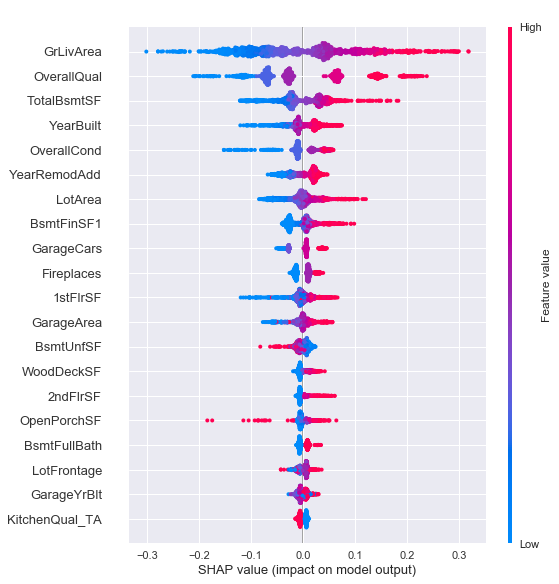

In [126]:
# summarize the effects of all the features
shap.summary_plot(shap_values, X_train_xgboost)

GrLivArea: Above grade (ground) living area square feet is the most important according to this model!

OverallQual: Overall material and finish quality

# Now, this got really cool, because the Shapley decomposition gives you values in both directions (positives and negatives). So I way inspect the real importance of the feature, is to inspect the mean (or sum) of the ABSOLUTE VALUES (the library itself has this implemented)! Just as below:

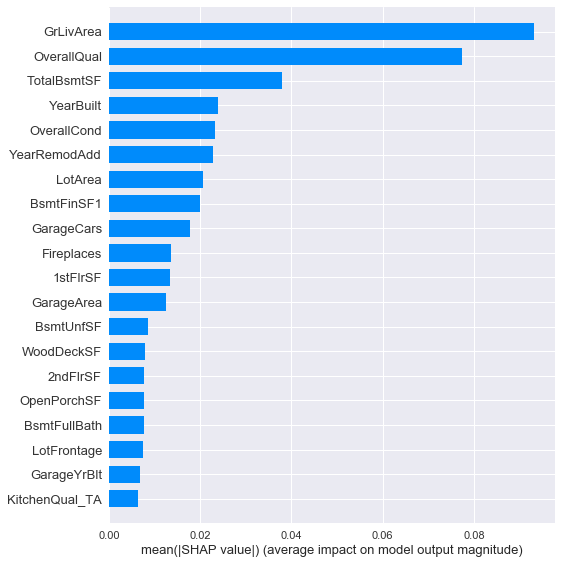

In [154]:
shap.summary_plot(shap_values, X_train_xgboost, plot_type="bar")

In [ ]:
np.abs(shap_values)

## It is possible to inspect the importance taking into consideration the direction (most important negative and most important positive)

In [170]:
# We need to convert to pandas to use seaborn later
features_df = pd.DataFrame(shap_values.mean(axis = 0), columns=['Mean']) # np.abs(shap_values) if we wanted the absolute values
features_df['Feature_Name'] = imputed_DF.columns
final_features_df = features_df.sort_values('Mean', ascending = True)
final_features_df.head()

,Mean,Feature_Name
25,-0.000918,GarageCars
12,-0.000783,1stFlrSF
2,-0.000696,LotArea
7,-0.000642,MasVnrArea
8,-0.000590,BsmtFinSF1


In [171]:
final_features_df.tail()

,Mean,Feature_Name
170,0.000343,ExterCond_Fa
3,0.000648,OverallQual
36,0.000817,MSZoning_C (all)
4,0.000992,OverallCond
215,0.001102,CentralAir_N


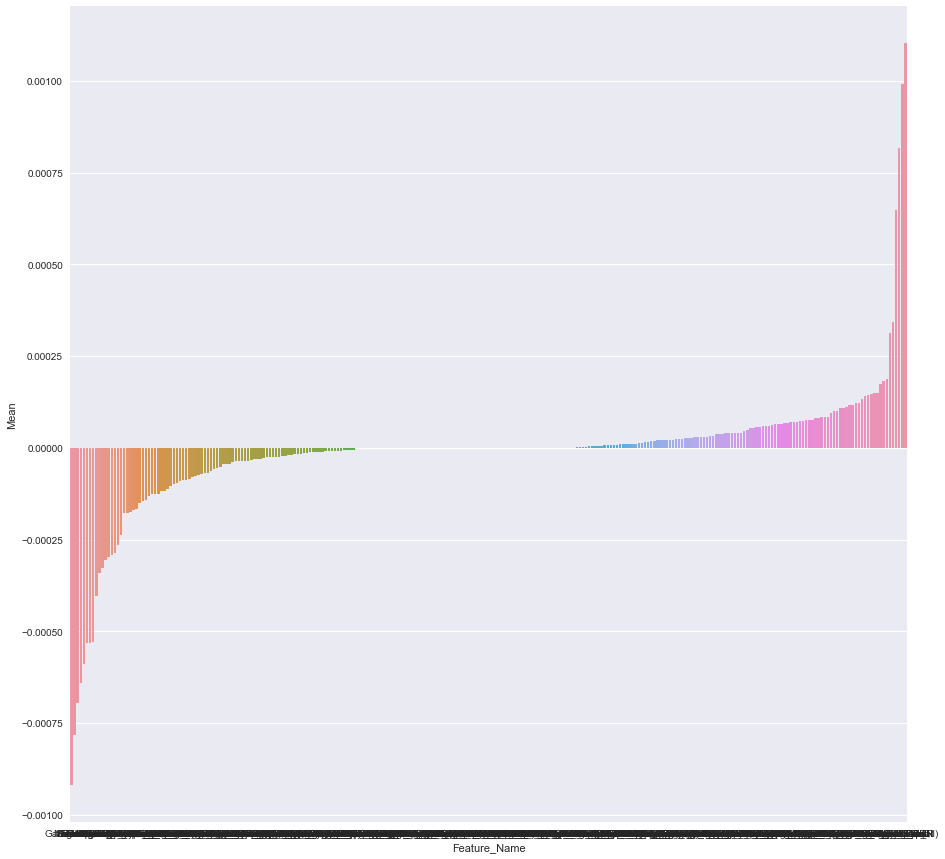

In [172]:
ax = sns.barplot(x="Feature_Name", y="Mean", data=final_features_df)

### Getting back to the modelling...

Since I improved some positions, I'll fit this to the FULL DATA:

In [ ]:
full_gbm = xgb.XGBRegressor(objective = 'reg:linear', params = grid_mse.best_params_)
full_gbm.fit(X, y_log)

In [ ]:
y_true, y_pred = y_valid, full_gbm.predict(X_valid)
np.sqrt(np.mean((y_true - y_pred) ** 2))

This can be the effect of the overfitting, because this model performed worse in the public score as you can see two cells below: 

### The lesson of this is that, maybe is not worth to train your model always with the Full Data after finding the 'best model'... because this can lead to overfitting.

In [ ]:
y_pred = np.exp(full_gbm.predict(test_X))

In [ ]:
final_sub = pd.DataFrame.from_dict({'Id': test_data.Id, 'SalePrice': y_pred})
final_sub.to_csv('XGBoost_tuned_grid_search_logarithmic_scale_trained_with_TRAIN_DATA_but_fit_to_FULL_DATA.csv', sep=',', index = False) # Public Score: 0.13916. It decresaed the performance!

### Using Randomized Search:

In [222]:
from sklearn.model_selection import RandomizedSearchCV
gbm = xgb.XGBRegressor()
random_mse = RandomizedSearchCV(estimator=gbm,
                                param_distributions=gbm_param_grid, # The name of this argument is slightly different from the grid search
                                scoring='neg_mean_squared_error', 
                                cv=4, 
                                verbose=1,
                                n_iter = 5,
                                n_jobs = -1)

random_mse.fit(X_train, y_train)

Fitting 4 folds for each of 5 candidates, totalling 20 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 out of  20 | elapsed:   25.8s remaining:    2.8s
[Parallel(n_jobs=-1)]: Done  20 out of  20 | elapsed:   26.1s finished


RandomizedSearchCV(cv=4, error_score='raise-deprecating',
          estimator=XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
       colsample_bytree=1, gamma=0, learning_rate=0.1, max_delta_step=0,
       max_depth=3, min_child_weight=1, missing=None, n_estimators=100,
       n_jobs=1, nthread=None, objective='reg:linear', random_state=0,
       reg_alpha=0, reg_lambda=1, scale_pos_weight=1, seed=None,
       silent=True, subsample=1),
          fit_params=None, iid='warn', n_iter=5, n_jobs=-1,
          param_distributions={'learning_rate': [0.01, 0.1, 0.5, 0.9], 'n_estimators': [200, 1000], 'subsample': [0.3, 0.5, 0.9], 'colsample_bytree': [0.6, 0.8], 'max_depth': [3, 5, 7], 'min_child_weight': [4, 5, 6]},
          pre_dispatch='2*n_jobs', random_state=None, refit=True,
          return_train_score='warn', scoring='neg_mean_squared_error',
          verbose=1)

In [229]:
y_true, y_pred = y_valid, random_mse.predict(X_valid)
np.sqrt(np.mean((y_true - y_pred) ** 2))

0.11827612453577732

In [224]:
y_pred = np.exp(random_mse.predict(test_X))
final_sub = pd.DataFrame.from_dict({'Id': test_data.Id, 'SalePrice': y_pred})
final_sub.to_csv('XGBoost_randomized_grid_search_logarithmic_scale_trained_with_TRAIN_DATA.csv', 
                 sep=',',
                 index = False) # Public score: 0.13205 didn't improve

# Light GBM

In [195]:
import lightgbm as lgb
train_data = lgb.Dataset(X_train, y_train)
val_data = lgb.Dataset(X_valid, y_valid)

List of the hyperparameters: https://lightgbm.readthedocs.io/en/latest/Parameters.html

In [207]:
#random_state = 1234
#params = {
#    "objective" : "regression", "metric" : "mean_absolute_percentage_error", "boosting": 'gbdt', "max_depth" : -1, "num_leaves" : 13,
#    "learning_rate" : 0.01, "bagging_freq": 5, "bagging_fraction" : 0.4, "feature_fraction" : 0.05,
#    "min_data_in_leaf": 80, "min_sum_heassian_in_leaf": 10, "tree_learner": "serial", "boost_from_average": "false",
#    "bagging_seed" : random_state, "verbosity" : 1, "seed": random_state
#}

In [213]:
# Let's go with the 'default' parameters
params = {
    "objective" : "regression", 
    "metric" : "mean_absolute_percentage_error"
}

In [214]:
lgb_clf = lgb.train(params, train_data, num_boost_round = 10000, valid_sets = [train_data, val_data])

[1]	training's mape: 0.0241619	valid_1's mape: 0.0220062
[2]	training's mape: 0.0220594	valid_1's mape: 0.0202097
[3]	training's mape: 0.0201746	valid_1's mape: 0.0186189
[4]	training's mape: 0.0185013	valid_1's mape: 0.0172175
[5]	training's mape: 0.0169937	valid_1's mape: 0.015962
[6]	training's mape: 0.0156594	valid_1's mape: 0.0148803
[7]	training's mape: 0.0144464	valid_1's mape: 0.0138615
[8]	training's mape: 0.0133862	valid_1's mape: 0.0129987
[9]	training's mape: 0.0124182	valid_1's mape: 0.0121679
[10]	training's mape: 0.0115603	valid_1's mape: 0.0114644
[11]	training's mape: 0.0107883	valid_1's mape: 0.0108724
[12]	training's mape: 0.0100728	valid_1's mape: 0.0103541
[13]	training's mape: 0.0094494	valid_1's mape: 0.00995523
[14]	training's mape: 0.00891429	valid_1's mape: 0.00961439
[15]	training's mape: 0.00842788	valid_1's mape: 0.00934584
[16]	training's mape: 0.00800816	valid_1's mape: 0.00908337
[17]	training's mape: 0.00763071	valid_1's mape: 0.00885389
[18]	training's

[197]	training's mape: 0.00106321	valid_1's mape: 0.00763645
[198]	training's mape: 0.00105702	valid_1's mape: 0.00763381
[199]	training's mape: 0.00105012	valid_1's mape: 0.00763569
[200]	training's mape: 0.00104379	valid_1's mape: 0.00763506
[201]	training's mape: 0.00103616	valid_1's mape: 0.00763677
[202]	training's mape: 0.0010295	valid_1's mape: 0.00763534
[203]	training's mape: 0.00102212	valid_1's mape: 0.00763453
[204]	training's mape: 0.00101578	valid_1's mape: 0.0076329
[205]	training's mape: 0.00100986	valid_1's mape: 0.00763569
[206]	training's mape: 0.00100427	valid_1's mape: 0.00763958
[207]	training's mape: 0.000997723	valid_1's mape: 0.00764137
[208]	training's mape: 0.000990704	valid_1's mape: 0.00764336
[209]	training's mape: 0.000984648	valid_1's mape: 0.00764734
[210]	training's mape: 0.000979004	valid_1's mape: 0.00764607
[211]	training's mape: 0.000973256	valid_1's mape: 0.00764473
[212]	training's mape: 0.000965533	valid_1's mape: 0.00764396
[213]	training's map

[389]	training's mape: 0.000346835	valid_1's mape: 0.00771393
[390]	training's mape: 0.000345428	valid_1's mape: 0.00771422
[391]	training's mape: 0.000343604	valid_1's mape: 0.00771338
[392]	training's mape: 0.000341302	valid_1's mape: 0.00771466
[393]	training's mape: 0.000339092	valid_1's mape: 0.00771366
[394]	training's mape: 0.000336823	valid_1's mape: 0.00771303
[395]	training's mape: 0.00033559	valid_1's mape: 0.00771432
[396]	training's mape: 0.000333633	valid_1's mape: 0.00771367
[397]	training's mape: 0.000332244	valid_1's mape: 0.00771427
[398]	training's mape: 0.000329918	valid_1's mape: 0.00771454
[399]	training's mape: 0.000327546	valid_1's mape: 0.00771485
[400]	training's mape: 0.000325449	valid_1's mape: 0.00771451
[401]	training's mape: 0.000324536	valid_1's mape: 0.00771483
[402]	training's mape: 0.000323116	valid_1's mape: 0.00771485
[403]	training's mape: 0.00032188	valid_1's mape: 0.00771589
[404]	training's mape: 0.000319969	valid_1's mape: 0.00771574
[405]	trai

[582]	training's mape: 0.000133474	valid_1's mape: 0.00773746
[583]	training's mape: 0.000133102	valid_1's mape: 0.00773751
[584]	training's mape: 0.000132568	valid_1's mape: 0.00773754
[585]	training's mape: 0.000132107	valid_1's mape: 0.00773738
[586]	training's mape: 0.000131506	valid_1's mape: 0.00773741
[587]	training's mape: 0.000130867	valid_1's mape: 0.00773771
[588]	training's mape: 0.000130033	valid_1's mape: 0.00773795
[589]	training's mape: 0.000129255	valid_1's mape: 0.00773817
[590]	training's mape: 0.000128752	valid_1's mape: 0.00773813
[591]	training's mape: 0.000128087	valid_1's mape: 0.00773758
[592]	training's mape: 0.000127513	valid_1's mape: 0.00773746
[593]	training's mape: 0.00012701	valid_1's mape: 0.00773702
[594]	training's mape: 0.000126697	valid_1's mape: 0.00773765
[595]	training's mape: 0.000125984	valid_1's mape: 0.0077381
[596]	training's mape: 0.000125568	valid_1's mape: 0.00773821
[597]	training's mape: 0.000125379	valid_1's mape: 0.00773904
[598]	trai

[778]	training's mape: 5.58256e-05	valid_1's mape: 0.00774694
[779]	training's mape: 5.54645e-05	valid_1's mape: 0.00774655
[780]	training's mape: 5.50561e-05	valid_1's mape: 0.00774675
[781]	training's mape: 5.47169e-05	valid_1's mape: 0.00774707
[782]	training's mape: 5.46662e-05	valid_1's mape: 0.00774713
[783]	training's mape: 5.44434e-05	valid_1's mape: 0.00774702
[784]	training's mape: 5.42384e-05	valid_1's mape: 0.00774701
[785]	training's mape: 5.41489e-05	valid_1's mape: 0.00774699
[786]	training's mape: 5.37769e-05	valid_1's mape: 0.00774683
[787]	training's mape: 5.36223e-05	valid_1's mape: 0.0077469
[788]	training's mape: 5.33524e-05	valid_1's mape: 0.00774701
[789]	training's mape: 5.30776e-05	valid_1's mape: 0.00774704
[790]	training's mape: 5.2752e-05	valid_1's mape: 0.00774694
[791]	training's mape: 5.24298e-05	valid_1's mape: 0.00774687
[792]	training's mape: 5.20569e-05	valid_1's mape: 0.00774686
[793]	training's mape: 5.19317e-05	valid_1's mape: 0.00774716
[794]	trai

[974]	training's mape: 2.59469e-05	valid_1's mape: 0.00774893
[975]	training's mape: 2.5828e-05	valid_1's mape: 0.00774897
[976]	training's mape: 2.57858e-05	valid_1's mape: 0.00774908
[977]	training's mape: 2.57194e-05	valid_1's mape: 0.00774909
[978]	training's mape: 2.56483e-05	valid_1's mape: 0.00774907
[979]	training's mape: 2.55751e-05	valid_1's mape: 0.00774896
[980]	training's mape: 2.55901e-05	valid_1's mape: 0.00774899
[981]	training's mape: 2.5489e-05	valid_1's mape: 0.00774896
[982]	training's mape: 2.54026e-05	valid_1's mape: 0.00774897
[983]	training's mape: 2.53867e-05	valid_1's mape: 0.0077489
[984]	training's mape: 2.52187e-05	valid_1's mape: 0.00774902
[985]	training's mape: 2.51201e-05	valid_1's mape: 0.00774904
[986]	training's mape: 2.50875e-05	valid_1's mape: 0.00774906
[987]	training's mape: 2.50525e-05	valid_1's mape: 0.00774905
[988]	training's mape: 2.50239e-05	valid_1's mape: 0.00774922
[989]	training's mape: 2.49022e-05	valid_1's mape: 0.00774925
[990]	train

[1168]	training's mape: 1.44489e-05	valid_1's mape: 0.00775046
[1169]	training's mape: 1.43846e-05	valid_1's mape: 0.00775047
[1170]	training's mape: 1.43411e-05	valid_1's mape: 0.00775046
[1171]	training's mape: 1.42945e-05	valid_1's mape: 0.00775053
[1172]	training's mape: 1.4269e-05	valid_1's mape: 0.0077505
[1173]	training's mape: 1.42318e-05	valid_1's mape: 0.00775048
[1174]	training's mape: 1.42042e-05	valid_1's mape: 0.00775051
[1175]	training's mape: 1.41294e-05	valid_1's mape: 0.0077505
[1176]	training's mape: 1.41032e-05	valid_1's mape: 0.00775051
[1177]	training's mape: 1.408e-05	valid_1's mape: 0.00775049
[1178]	training's mape: 1.40596e-05	valid_1's mape: 0.00775051
[1179]	training's mape: 1.40394e-05	valid_1's mape: 0.00775051
[1180]	training's mape: 1.39953e-05	valid_1's mape: 0.00775052
[1181]	training's mape: 1.39961e-05	valid_1's mape: 0.00775054
[1182]	training's mape: 1.39529e-05	valid_1's mape: 0.00775053
[1183]	training's mape: 1.39368e-05	valid_1's mape: 0.007750

[1364]	training's mape: 8.31227e-06	valid_1's mape: 0.00775163
[1365]	training's mape: 8.27166e-06	valid_1's mape: 0.00775164
[1366]	training's mape: 8.24991e-06	valid_1's mape: 0.00775164
[1367]	training's mape: 8.22838e-06	valid_1's mape: 0.00775163
[1368]	training's mape: 8.24966e-06	valid_1's mape: 0.0077517
[1369]	training's mape: 8.21432e-06	valid_1's mape: 0.00775169
[1370]	training's mape: 8.23004e-06	valid_1's mape: 0.00775175
[1371]	training's mape: 8.21813e-06	valid_1's mape: 0.00775178
[1372]	training's mape: 8.21253e-06	valid_1's mape: 0.00775186
[1373]	training's mape: 8.19915e-06	valid_1's mape: 0.00775188
[1374]	training's mape: 8.14188e-06	valid_1's mape: 0.00775189
[1375]	training's mape: 8.11332e-06	valid_1's mape: 0.00775187
[1376]	training's mape: 8.12337e-06	valid_1's mape: 0.00775184
[1377]	training's mape: 8.07779e-06	valid_1's mape: 0.00775181
[1378]	training's mape: 8.02502e-06	valid_1's mape: 0.00775181
[1379]	training's mape: 8.00431e-06	valid_1's mape: 0.00

[1561]	training's mape: 5.05278e-06	valid_1's mape: 0.00775206
[1562]	training's mape: 5.0674e-06	valid_1's mape: 0.00775209
[1563]	training's mape: 5.05012e-06	valid_1's mape: 0.00775209
[1564]	training's mape: 5.00945e-06	valid_1's mape: 0.00775208
[1565]	training's mape: 4.98656e-06	valid_1's mape: 0.00775208
[1566]	training's mape: 4.98233e-06	valid_1's mape: 0.00775209
[1567]	training's mape: 4.97576e-06	valid_1's mape: 0.00775208
[1568]	training's mape: 4.95915e-06	valid_1's mape: 0.00775211
[1569]	training's mape: 4.94991e-06	valid_1's mape: 0.0077521
[1570]	training's mape: 4.96249e-06	valid_1's mape: 0.0077521
[1571]	training's mape: 4.93841e-06	valid_1's mape: 0.00775211
[1572]	training's mape: 4.92211e-06	valid_1's mape: 0.00775211
[1573]	training's mape: 4.91304e-06	valid_1's mape: 0.00775211
[1574]	training's mape: 4.9204e-06	valid_1's mape: 0.00775211
[1575]	training's mape: 4.90709e-06	valid_1's mape: 0.00775211
[1576]	training's mape: 4.92254e-06	valid_1's mape: 0.00775

[1761]	training's mape: 3.43505e-06	valid_1's mape: 0.00775271
[1762]	training's mape: 3.41976e-06	valid_1's mape: 0.00775272
[1763]	training's mape: 3.41065e-06	valid_1's mape: 0.00775273
[1764]	training's mape: 3.4054e-06	valid_1's mape: 0.00775273
[1765]	training's mape: 3.40536e-06	valid_1's mape: 0.00775272
[1766]	training's mape: 3.38706e-06	valid_1's mape: 0.00775273
[1767]	training's mape: 3.39821e-06	valid_1's mape: 0.00775276
[1768]	training's mape: 3.38902e-06	valid_1's mape: 0.00775277
[1769]	training's mape: 3.39297e-06	valid_1's mape: 0.00775276
[1770]	training's mape: 3.38196e-06	valid_1's mape: 0.00775276
[1771]	training's mape: 3.39193e-06	valid_1's mape: 0.00775275
[1772]	training's mape: 3.38674e-06	valid_1's mape: 0.00775276
[1773]	training's mape: 3.3665e-06	valid_1's mape: 0.00775276
[1774]	training's mape: 3.34939e-06	valid_1's mape: 0.00775276
[1775]	training's mape: 3.35371e-06	valid_1's mape: 0.00775277
[1776]	training's mape: 3.359e-06	valid_1's mape: 0.00775

[1959]	training's mape: 2.4684e-06	valid_1's mape: 0.00775317
[1960]	training's mape: 2.45624e-06	valid_1's mape: 0.00775317
[1961]	training's mape: 2.45916e-06	valid_1's mape: 0.00775317
[1962]	training's mape: 2.45237e-06	valid_1's mape: 0.00775318
[1963]	training's mape: 2.45366e-06	valid_1's mape: 0.00775318
[1964]	training's mape: 2.44966e-06	valid_1's mape: 0.0077532
[1965]	training's mape: 2.45387e-06	valid_1's mape: 0.00775321
[1966]	training's mape: 2.4432e-06	valid_1's mape: 0.0077532
[1967]	training's mape: 2.43671e-06	valid_1's mape: 0.0077532
[1968]	training's mape: 2.42839e-06	valid_1's mape: 0.00775322
[1969]	training's mape: 2.43901e-06	valid_1's mape: 0.00775323
[1970]	training's mape: 2.44006e-06	valid_1's mape: 0.00775324
[1971]	training's mape: 2.42332e-06	valid_1's mape: 0.00775323
[1972]	training's mape: 2.41159e-06	valid_1's mape: 0.00775323
[1973]	training's mape: 2.40925e-06	valid_1's mape: 0.00775322
[1974]	training's mape: 2.41071e-06	valid_1's mape: 0.007753

[2166]	training's mape: 1.78819e-06	valid_1's mape: 0.00775341
[2167]	training's mape: 1.77766e-06	valid_1's mape: 0.00775341
[2168]	training's mape: 1.76698e-06	valid_1's mape: 0.00775341
[2169]	training's mape: 1.75512e-06	valid_1's mape: 0.00775341
[2170]	training's mape: 1.76499e-06	valid_1's mape: 0.00775341
[2171]	training's mape: 1.76904e-06	valid_1's mape: 0.0077534
[2172]	training's mape: 1.764e-06	valid_1's mape: 0.0077534
[2173]	training's mape: 1.75905e-06	valid_1's mape: 0.00775341
[2174]	training's mape: 1.756e-06	valid_1's mape: 0.0077534
[2175]	training's mape: 1.75293e-06	valid_1's mape: 0.00775342
[2176]	training's mape: 1.75473e-06	valid_1's mape: 0.00775344
[2177]	training's mape: 1.74523e-06	valid_1's mape: 0.00775344
[2178]	training's mape: 1.73822e-06	valid_1's mape: 0.00775344
[2179]	training's mape: 1.74172e-06	valid_1's mape: 0.00775345
[2180]	training's mape: 1.7299e-06	valid_1's mape: 0.00775344
[2181]	training's mape: 1.73276e-06	valid_1's mape: 0.00775344


[2372]	training's mape: 1.27256e-06	valid_1's mape: 0.00775355
[2373]	training's mape: 1.27147e-06	valid_1's mape: 0.00775354
[2374]	training's mape: 1.27133e-06	valid_1's mape: 0.00775355
[2375]	training's mape: 1.26723e-06	valid_1's mape: 0.00775354
[2376]	training's mape: 1.26237e-06	valid_1's mape: 0.00775354
[2377]	training's mape: 1.25483e-06	valid_1's mape: 0.00775354
[2378]	training's mape: 1.24857e-06	valid_1's mape: 0.00775354
[2379]	training's mape: 1.25079e-06	valid_1's mape: 0.00775354
[2380]	training's mape: 1.24199e-06	valid_1's mape: 0.00775354
[2381]	training's mape: 1.23352e-06	valid_1's mape: 0.00775354
[2382]	training's mape: 1.24694e-06	valid_1's mape: 0.00775355
[2383]	training's mape: 1.24997e-06	valid_1's mape: 0.00775356
[2384]	training's mape: 1.25524e-06	valid_1's mape: 0.00775357
[2385]	training's mape: 1.2486e-06	valid_1's mape: 0.00775356
[2386]	training's mape: 1.24259e-06	valid_1's mape: 0.00775356
[2387]	training's mape: 1.24832e-06	valid_1's mape: 0.00

[2577]	training's mape: 9.25548e-07	valid_1's mape: 0.00775367
[2578]	training's mape: 9.22949e-07	valid_1's mape: 0.00775366
[2579]	training's mape: 9.20626e-07	valid_1's mape: 0.00775367
[2580]	training's mape: 9.1311e-07	valid_1's mape: 0.00775366
[2581]	training's mape: 9.08037e-07	valid_1's mape: 0.00775366
[2582]	training's mape: 9.05647e-07	valid_1's mape: 0.00775366
[2583]	training's mape: 9.0611e-07	valid_1's mape: 0.00775366
[2584]	training's mape: 9.00332e-07	valid_1's mape: 0.00775367
[2585]	training's mape: 8.97746e-07	valid_1's mape: 0.00775367
[2586]	training's mape: 8.94835e-07	valid_1's mape: 0.00775367
[2587]	training's mape: 8.93269e-07	valid_1's mape: 0.00775367
[2588]	training's mape: 8.91939e-07	valid_1's mape: 0.00775367
[2589]	training's mape: 8.99994e-07	valid_1's mape: 0.00775366
[2590]	training's mape: 9.02193e-07	valid_1's mape: 0.00775366
[2591]	training's mape: 9.05353e-07	valid_1's mape: 0.00775366
[2592]	training's mape: 8.9964e-07	valid_1's mape: 0.0077

[2787]	training's mape: 6.61543e-07	valid_1's mape: 0.00775372
[2788]	training's mape: 6.63369e-07	valid_1's mape: 0.00775372
[2789]	training's mape: 6.68853e-07	valid_1's mape: 0.00775372
[2790]	training's mape: 6.6343e-07	valid_1's mape: 0.00775373
[2791]	training's mape: 6.57995e-07	valid_1's mape: 0.00775373
[2792]	training's mape: 6.54081e-07	valid_1's mape: 0.00775373
[2793]	training's mape: 6.59364e-07	valid_1's mape: 0.00775373
[2794]	training's mape: 6.61282e-07	valid_1's mape: 0.00775373
[2795]	training's mape: 6.57517e-07	valid_1's mape: 0.00775373
[2796]	training's mape: 6.55583e-07	valid_1's mape: 0.00775374
[2797]	training's mape: 6.53586e-07	valid_1's mape: 0.00775374
[2798]	training's mape: 6.49633e-07	valid_1's mape: 0.00775374
[2799]	training's mape: 6.4487e-07	valid_1's mape: 0.00775374
[2800]	training's mape: 6.45117e-07	valid_1's mape: 0.00775374
[2801]	training's mape: 6.49597e-07	valid_1's mape: 0.00775373
[2802]	training's mape: 6.51452e-07	valid_1's mape: 0.007

[2997]	training's mape: 4.87261e-07	valid_1's mape: 0.00775382
[2998]	training's mape: 4.91409e-07	valid_1's mape: 0.00775382
[2999]	training's mape: 4.93265e-07	valid_1's mape: 0.00775382
[3000]	training's mape: 4.96204e-07	valid_1's mape: 0.00775382
[3001]	training's mape: 5.01651e-07	valid_1's mape: 0.00775382
[3002]	training's mape: 5.02165e-07	valid_1's mape: 0.00775382
[3003]	training's mape: 5.00727e-07	valid_1's mape: 0.00775382
[3004]	training's mape: 4.99202e-07	valid_1's mape: 0.00775382
[3005]	training's mape: 5.06932e-07	valid_1's mape: 0.00775382
[3006]	training's mape: 5.06827e-07	valid_1's mape: 0.00775382
[3007]	training's mape: 5.0714e-07	valid_1's mape: 0.00775382
[3008]	training's mape: 5.06078e-07	valid_1's mape: 0.00775383
[3009]	training's mape: 5.06376e-07	valid_1's mape: 0.00775383
[3010]	training's mape: 5.01866e-07	valid_1's mape: 0.00775383
[3011]	training's mape: 5.02575e-07	valid_1's mape: 0.00775383
[3012]	training's mape: 4.98151e-07	valid_1's mape: 0.00

[3203]	training's mape: 3.58103e-07	valid_1's mape: 0.00775386
[3204]	training's mape: 3.57911e-07	valid_1's mape: 0.00775386
[3205]	training's mape: 3.61304e-07	valid_1's mape: 0.00775386
[3206]	training's mape: 3.61346e-07	valid_1's mape: 0.00775387
[3207]	training's mape: 3.59475e-07	valid_1's mape: 0.00775387
[3208]	training's mape: 3.58232e-07	valid_1's mape: 0.00775386
[3209]	training's mape: 3.59363e-07	valid_1's mape: 0.00775387
[3210]	training's mape: 3.58468e-07	valid_1's mape: 0.00775387
[3211]	training's mape: 3.55922e-07	valid_1's mape: 0.00775387
[3212]	training's mape: 3.53041e-07	valid_1's mape: 0.00775387
[3213]	training's mape: 3.51864e-07	valid_1's mape: 0.00775386
[3214]	training's mape: 3.54701e-07	valid_1's mape: 0.00775387
[3215]	training's mape: 3.53502e-07	valid_1's mape: 0.00775386
[3216]	training's mape: 3.53196e-07	valid_1's mape: 0.00775386
[3217]	training's mape: 3.51396e-07	valid_1's mape: 0.00775386
[3218]	training's mape: 3.50891e-07	valid_1's mape: 0.0

[3408]	training's mape: 2.67648e-07	valid_1's mape: 0.0077539
[3409]	training's mape: 2.69218e-07	valid_1's mape: 0.0077539
[3410]	training's mape: 2.70407e-07	valid_1's mape: 0.0077539
[3411]	training's mape: 2.71177e-07	valid_1's mape: 0.0077539
[3412]	training's mape: 2.70846e-07	valid_1's mape: 0.0077539
[3413]	training's mape: 2.72562e-07	valid_1's mape: 0.0077539
[3414]	training's mape: 2.71793e-07	valid_1's mape: 0.0077539
[3415]	training's mape: 2.7129e-07	valid_1's mape: 0.0077539
[3416]	training's mape: 2.70359e-07	valid_1's mape: 0.0077539
[3417]	training's mape: 2.70926e-07	valid_1's mape: 0.0077539
[3418]	training's mape: 2.69865e-07	valid_1's mape: 0.0077539
[3419]	training's mape: 2.68247e-07	valid_1's mape: 0.0077539
[3420]	training's mape: 2.67203e-07	valid_1's mape: 0.0077539
[3421]	training's mape: 2.66723e-07	valid_1's mape: 0.0077539
[3422]	training's mape: 2.66732e-07	valid_1's mape: 0.0077539
[3423]	training's mape: 2.68169e-07	valid_1's mape: 0.0077539
[3424]	tr

[3615]	training's mape: 2.00582e-07	valid_1's mape: 0.00775393
[3616]	training's mape: 2.00459e-07	valid_1's mape: 0.00775393
[3617]	training's mape: 2.0172e-07	valid_1's mape: 0.00775393
[3618]	training's mape: 2.01217e-07	valid_1's mape: 0.00775393
[3619]	training's mape: 2.00386e-07	valid_1's mape: 0.00775393
[3620]	training's mape: 1.99704e-07	valid_1's mape: 0.00775393
[3621]	training's mape: 1.99781e-07	valid_1's mape: 0.00775393
[3622]	training's mape: 2.00878e-07	valid_1's mape: 0.00775393
[3623]	training's mape: 2.01881e-07	valid_1's mape: 0.00775393
[3624]	training's mape: 2.01329e-07	valid_1's mape: 0.00775393
[3625]	training's mape: 2.01579e-07	valid_1's mape: 0.00775393
[3626]	training's mape: 2.00736e-07	valid_1's mape: 0.00775393
[3627]	training's mape: 1.99993e-07	valid_1's mape: 0.00775393
[3628]	training's mape: 1.99907e-07	valid_1's mape: 0.00775393
[3629]	training's mape: 1.98367e-07	valid_1's mape: 0.00775393
[3630]	training's mape: 1.97516e-07	valid_1's mape: 0.00

[3819]	training's mape: 1.49792e-07	valid_1's mape: 0.00775396
[3820]	training's mape: 1.49248e-07	valid_1's mape: 0.00775396
[3821]	training's mape: 1.50036e-07	valid_1's mape: 0.00775396
[3822]	training's mape: 1.48972e-07	valid_1's mape: 0.00775396
[3823]	training's mape: 1.48715e-07	valid_1's mape: 0.00775396
[3824]	training's mape: 1.47874e-07	valid_1's mape: 0.00775396
[3825]	training's mape: 1.47914e-07	valid_1's mape: 0.00775396
[3826]	training's mape: 1.47808e-07	valid_1's mape: 0.00775396
[3827]	training's mape: 1.4699e-07	valid_1's mape: 0.00775396
[3828]	training's mape: 1.4633e-07	valid_1's mape: 0.00775396
[3829]	training's mape: 1.45499e-07	valid_1's mape: 0.00775396
[3830]	training's mape: 1.46776e-07	valid_1's mape: 0.00775396
[3831]	training's mape: 1.46134e-07	valid_1's mape: 0.00775396
[3832]	training's mape: 1.45396e-07	valid_1's mape: 0.00775396
[3833]	training's mape: 1.45695e-07	valid_1's mape: 0.00775396
[3834]	training's mape: 1.45121e-07	valid_1's mape: 0.007

[4015]	training's mape: 1.14787e-07	valid_1's mape: 0.00775398
[4016]	training's mape: 1.14651e-07	valid_1's mape: 0.00775398
[4017]	training's mape: 1.13973e-07	valid_1's mape: 0.00775398
[4018]	training's mape: 1.13723e-07	valid_1's mape: 0.00775398
[4019]	training's mape: 1.12688e-07	valid_1's mape: 0.00775398
[4020]	training's mape: 1.122e-07	valid_1's mape: 0.00775398
[4021]	training's mape: 1.12135e-07	valid_1's mape: 0.00775398
[4022]	training's mape: 1.12365e-07	valid_1's mape: 0.00775398
[4023]	training's mape: 1.11685e-07	valid_1's mape: 0.00775398
[4024]	training's mape: 1.11139e-07	valid_1's mape: 0.00775398
[4025]	training's mape: 1.12062e-07	valid_1's mape: 0.00775398
[4026]	training's mape: 1.11384e-07	valid_1's mape: 0.00775398
[4027]	training's mape: 1.10888e-07	valid_1's mape: 0.00775398
[4028]	training's mape: 1.10753e-07	valid_1's mape: 0.00775398
[4029]	training's mape: 1.09919e-07	valid_1's mape: 0.00775398
[4030]	training's mape: 1.09594e-07	valid_1's mape: 0.007

[4218]	training's mape: 8.54478e-08	valid_1's mape: 0.007754
[4219]	training's mape: 8.49079e-08	valid_1's mape: 0.007754
[4220]	training's mape: 8.53893e-08	valid_1's mape: 0.007754
[4221]	training's mape: 8.5114e-08	valid_1's mape: 0.007754
[4222]	training's mape: 8.59425e-08	valid_1's mape: 0.007754
[4223]	training's mape: 8.60298e-08	valid_1's mape: 0.007754
[4224]	training's mape: 8.64687e-08	valid_1's mape: 0.007754
[4225]	training's mape: 8.6901e-08	valid_1's mape: 0.007754
[4226]	training's mape: 8.64049e-08	valid_1's mape: 0.007754
[4227]	training's mape: 8.70741e-08	valid_1's mape: 0.007754
[4228]	training's mape: 8.64962e-08	valid_1's mape: 0.007754
[4229]	training's mape: 8.64329e-08	valid_1's mape: 0.007754
[4230]	training's mape: 8.60436e-08	valid_1's mape: 0.007754
[4231]	training's mape: 8.69531e-08	valid_1's mape: 0.007754
[4232]	training's mape: 8.61744e-08	valid_1's mape: 0.007754
[4233]	training's mape: 8.55678e-08	valid_1's mape: 0.007754
[4234]	training's mape: 8.

[4417]	training's mape: 6.39835e-08	valid_1's mape: 0.00775401
[4418]	training's mape: 6.43022e-08	valid_1's mape: 0.00775401
[4419]	training's mape: 6.42651e-08	valid_1's mape: 0.00775401
[4420]	training's mape: 6.38203e-08	valid_1's mape: 0.00775401
[4421]	training's mape: 6.34372e-08	valid_1's mape: 0.00775401
[4422]	training's mape: 6.31985e-08	valid_1's mape: 0.00775401
[4423]	training's mape: 6.3535e-08	valid_1's mape: 0.00775401
[4424]	training's mape: 6.35416e-08	valid_1's mape: 0.00775401
[4425]	training's mape: 6.3106e-08	valid_1's mape: 0.00775401
[4426]	training's mape: 6.28969e-08	valid_1's mape: 0.00775401
[4427]	training's mape: 6.31595e-08	valid_1's mape: 0.00775401
[4428]	training's mape: 6.33433e-08	valid_1's mape: 0.00775401
[4429]	training's mape: 6.30899e-08	valid_1's mape: 0.00775401
[4430]	training's mape: 6.30524e-08	valid_1's mape: 0.00775401
[4431]	training's mape: 6.2728e-08	valid_1's mape: 0.00775401
[4432]	training's mape: 6.26158e-08	valid_1's mape: 0.0077

[4619]	training's mape: 4.85635e-08	valid_1's mape: 0.00775401
[4620]	training's mape: 4.82083e-08	valid_1's mape: 0.00775401
[4621]	training's mape: 4.79804e-08	valid_1's mape: 0.00775401
[4622]	training's mape: 4.78432e-08	valid_1's mape: 0.00775401
[4623]	training's mape: 4.78487e-08	valid_1's mape: 0.00775402
[4624]	training's mape: 4.76264e-08	valid_1's mape: 0.00775402
[4625]	training's mape: 4.77658e-08	valid_1's mape: 0.00775401
[4626]	training's mape: 4.80028e-08	valid_1's mape: 0.00775401
[4627]	training's mape: 4.81175e-08	valid_1's mape: 0.00775401
[4628]	training's mape: 4.82382e-08	valid_1's mape: 0.00775402
[4629]	training's mape: 4.86089e-08	valid_1's mape: 0.00775401
[4630]	training's mape: 4.91395e-08	valid_1's mape: 0.00775402
[4631]	training's mape: 4.90479e-08	valid_1's mape: 0.00775402
[4632]	training's mape: 4.87691e-08	valid_1's mape: 0.00775401
[4633]	training's mape: 4.8288e-08	valid_1's mape: 0.00775402
[4634]	training's mape: 4.78953e-08	valid_1's mape: 0.00

[4828]	training's mape: 3.54223e-08	valid_1's mape: 0.00775402
[4829]	training's mape: 3.52683e-08	valid_1's mape: 0.00775402
[4830]	training's mape: 3.50632e-08	valid_1's mape: 0.00775402
[4831]	training's mape: 3.49508e-08	valid_1's mape: 0.00775402
[4832]	training's mape: 3.4839e-08	valid_1's mape: 0.00775402
[4833]	training's mape: 3.51707e-08	valid_1's mape: 0.00775402
[4834]	training's mape: 3.49504e-08	valid_1's mape: 0.00775402
[4835]	training's mape: 3.48309e-08	valid_1's mape: 0.00775402
[4836]	training's mape: 3.47689e-08	valid_1's mape: 0.00775402
[4837]	training's mape: 3.47013e-08	valid_1's mape: 0.00775402
[4838]	training's mape: 3.4604e-08	valid_1's mape: 0.00775402
[4839]	training's mape: 3.46067e-08	valid_1's mape: 0.00775402
[4840]	training's mape: 3.45272e-08	valid_1's mape: 0.00775402
[4841]	training's mape: 3.44932e-08	valid_1's mape: 0.00775402
[4842]	training's mape: 3.4353e-08	valid_1's mape: 0.00775402
[4843]	training's mape: 3.42939e-08	valid_1's mape: 0.0077

[5034]	training's mape: 2.72993e-08	valid_1's mape: 0.00775402
[5035]	training's mape: 2.70797e-08	valid_1's mape: 0.00775402
[5036]	training's mape: 2.69355e-08	valid_1's mape: 0.00775402
[5037]	training's mape: 2.68214e-08	valid_1's mape: 0.00775402
[5038]	training's mape: 2.66748e-08	valid_1's mape: 0.00775402
[5039]	training's mape: 2.69357e-08	valid_1's mape: 0.00775402
[5040]	training's mape: 2.69527e-08	valid_1's mape: 0.00775402
[5041]	training's mape: 2.70648e-08	valid_1's mape: 0.00775402
[5042]	training's mape: 2.70505e-08	valid_1's mape: 0.00775402
[5043]	training's mape: 2.67973e-08	valid_1's mape: 0.00775402
[5044]	training's mape: 2.69647e-08	valid_1's mape: 0.00775402
[5045]	training's mape: 2.68296e-08	valid_1's mape: 0.00775402
[5046]	training's mape: 2.69146e-08	valid_1's mape: 0.00775402
[5047]	training's mape: 2.67915e-08	valid_1's mape: 0.00775402
[5048]	training's mape: 2.65598e-08	valid_1's mape: 0.00775402
[5049]	training's mape: 2.65786e-08	valid_1's mape: 0.0

[5235]	training's mape: 2.02008e-08	valid_1's mape: 0.00775403
[5236]	training's mape: 2.00354e-08	valid_1's mape: 0.00775403
[5237]	training's mape: 1.99804e-08	valid_1's mape: 0.00775403
[5238]	training's mape: 1.99527e-08	valid_1's mape: 0.00775403
[5239]	training's mape: 2.01069e-08	valid_1's mape: 0.00775403
[5240]	training's mape: 2.01632e-08	valid_1's mape: 0.00775403
[5241]	training's mape: 2.00873e-08	valid_1's mape: 0.00775403
[5242]	training's mape: 2.0008e-08	valid_1's mape: 0.00775403
[5243]	training's mape: 1.98699e-08	valid_1's mape: 0.00775403
[5244]	training's mape: 1.98168e-08	valid_1's mape: 0.00775403
[5245]	training's mape: 1.97589e-08	valid_1's mape: 0.00775403
[5246]	training's mape: 1.95838e-08	valid_1's mape: 0.00775403
[5247]	training's mape: 1.97988e-08	valid_1's mape: 0.00775403
[5248]	training's mape: 1.99006e-08	valid_1's mape: 0.00775403
[5249]	training's mape: 1.97903e-08	valid_1's mape: 0.00775403
[5250]	training's mape: 1.96595e-08	valid_1's mape: 0.00

[5438]	training's mape: 1.51234e-08	valid_1's mape: 0.00775403
[5439]	training's mape: 1.50337e-08	valid_1's mape: 0.00775403
[5440]	training's mape: 1.49039e-08	valid_1's mape: 0.00775403
[5441]	training's mape: 1.49763e-08	valid_1's mape: 0.00775403
[5442]	training's mape: 1.51064e-08	valid_1's mape: 0.00775403
[5443]	training's mape: 1.50636e-08	valid_1's mape: 0.00775403
[5444]	training's mape: 1.51468e-08	valid_1's mape: 0.00775403
[5445]	training's mape: 1.52604e-08	valid_1's mape: 0.00775403
[5446]	training's mape: 1.51406e-08	valid_1's mape: 0.00775403
[5447]	training's mape: 1.50503e-08	valid_1's mape: 0.00775403
[5448]	training's mape: 1.50579e-08	valid_1's mape: 0.00775403
[5449]	training's mape: 1.50424e-08	valid_1's mape: 0.00775403
[5450]	training's mape: 1.50168e-08	valid_1's mape: 0.00775403
[5451]	training's mape: 1.49589e-08	valid_1's mape: 0.00775403
[5452]	training's mape: 1.49441e-08	valid_1's mape: 0.00775403
[5453]	training's mape: 1.49428e-08	valid_1's mape: 0.0

[5640]	training's mape: 1.19575e-08	valid_1's mape: 0.00775403
[5641]	training's mape: 1.19072e-08	valid_1's mape: 0.00775403
[5642]	training's mape: 1.18611e-08	valid_1's mape: 0.00775403
[5643]	training's mape: 1.17734e-08	valid_1's mape: 0.00775403
[5644]	training's mape: 1.18657e-08	valid_1's mape: 0.00775403
[5645]	training's mape: 1.18822e-08	valid_1's mape: 0.00775403
[5646]	training's mape: 1.17921e-08	valid_1's mape: 0.00775403
[5647]	training's mape: 1.17375e-08	valid_1's mape: 0.00775403
[5648]	training's mape: 1.17663e-08	valid_1's mape: 0.00775403
[5649]	training's mape: 1.17069e-08	valid_1's mape: 0.00775403
[5650]	training's mape: 1.1646e-08	valid_1's mape: 0.00775403
[5651]	training's mape: 1.16662e-08	valid_1's mape: 0.00775403
[5652]	training's mape: 1.17358e-08	valid_1's mape: 0.00775403
[5653]	training's mape: 1.18022e-08	valid_1's mape: 0.00775403
[5654]	training's mape: 1.19632e-08	valid_1's mape: 0.00775403
[5655]	training's mape: 1.19003e-08	valid_1's mape: 0.00

[5843]	training's mape: 8.93534e-09	valid_1's mape: 0.00775403
[5844]	training's mape: 8.98434e-09	valid_1's mape: 0.00775403
[5845]	training's mape: 9.00784e-09	valid_1's mape: 0.00775403
[5846]	training's mape: 9.02122e-09	valid_1's mape: 0.00775403
[5847]	training's mape: 8.95183e-09	valid_1's mape: 0.00775403
[5848]	training's mape: 8.86028e-09	valid_1's mape: 0.00775403
[5849]	training's mape: 8.8336e-09	valid_1's mape: 0.00775403
[5850]	training's mape: 8.8759e-09	valid_1's mape: 0.00775403
[5851]	training's mape: 8.8253e-09	valid_1's mape: 0.00775403
[5852]	training's mape: 8.74328e-09	valid_1's mape: 0.00775403
[5853]	training's mape: 8.73292e-09	valid_1's mape: 0.00775403
[5854]	training's mape: 8.69812e-09	valid_1's mape: 0.00775403
[5855]	training's mape: 8.66734e-09	valid_1's mape: 0.00775403
[5856]	training's mape: 8.64892e-09	valid_1's mape: 0.00775403
[5857]	training's mape: 8.72056e-09	valid_1's mape: 0.00775403
[5858]	training's mape: 8.72145e-09	valid_1's mape: 0.0077

[6049]	training's mape: 6.72961e-09	valid_1's mape: 0.00775403
[6050]	training's mape: 6.7528e-09	valid_1's mape: 0.00775403
[6051]	training's mape: 6.83097e-09	valid_1's mape: 0.00775403
[6052]	training's mape: 6.78434e-09	valid_1's mape: 0.00775403
[6053]	training's mape: 6.78426e-09	valid_1's mape: 0.00775403
[6054]	training's mape: 6.75449e-09	valid_1's mape: 0.00775403
[6055]	training's mape: 6.81342e-09	valid_1's mape: 0.00775403
[6056]	training's mape: 6.88017e-09	valid_1's mape: 0.00775403
[6057]	training's mape: 6.79118e-09	valid_1's mape: 0.00775403
[6058]	training's mape: 6.72611e-09	valid_1's mape: 0.00775403
[6059]	training's mape: 6.68749e-09	valid_1's mape: 0.00775403
[6060]	training's mape: 6.63263e-09	valid_1's mape: 0.00775403
[6061]	training's mape: 6.6173e-09	valid_1's mape: 0.00775403
[6062]	training's mape: 6.5821e-09	valid_1's mape: 0.00775403
[6063]	training's mape: 6.54981e-09	valid_1's mape: 0.00775403
[6064]	training's mape: 6.52388e-09	valid_1's mape: 0.0077

[6256]	training's mape: 4.93384e-09	valid_1's mape: 0.00775403
[6257]	training's mape: 4.93699e-09	valid_1's mape: 0.00775403
[6258]	training's mape: 4.97953e-09	valid_1's mape: 0.00775403
[6259]	training's mape: 4.96323e-09	valid_1's mape: 0.00775403
[6260]	training's mape: 4.98272e-09	valid_1's mape: 0.00775403
[6261]	training's mape: 4.95301e-09	valid_1's mape: 0.00775403
[6262]	training's mape: 4.91201e-09	valid_1's mape: 0.00775403
[6263]	training's mape: 4.87833e-09	valid_1's mape: 0.00775403
[6264]	training's mape: 4.84122e-09	valid_1's mape: 0.00775403
[6265]	training's mape: 4.86728e-09	valid_1's mape: 0.00775403
[6266]	training's mape: 4.88673e-09	valid_1's mape: 0.00775403
[6267]	training's mape: 4.85335e-09	valid_1's mape: 0.00775403
[6268]	training's mape: 4.81323e-09	valid_1's mape: 0.00775403
[6269]	training's mape: 4.81938e-09	valid_1's mape: 0.00775403
[6270]	training's mape: 4.87234e-09	valid_1's mape: 0.00775403
[6271]	training's mape: 4.87418e-09	valid_1's mape: 0.0

[6464]	training's mape: 3.63314e-09	valid_1's mape: 0.00775403
[6465]	training's mape: 3.66849e-09	valid_1's mape: 0.00775403
[6466]	training's mape: 3.6751e-09	valid_1's mape: 0.00775403
[6467]	training's mape: 3.64117e-09	valid_1's mape: 0.00775403
[6468]	training's mape: 3.61681e-09	valid_1's mape: 0.00775403
[6469]	training's mape: 3.59681e-09	valid_1's mape: 0.00775403
[6470]	training's mape: 3.57085e-09	valid_1's mape: 0.00775403
[6471]	training's mape: 3.56104e-09	valid_1's mape: 0.00775403
[6472]	training's mape: 3.53058e-09	valid_1's mape: 0.00775403
[6473]	training's mape: 3.52476e-09	valid_1's mape: 0.00775403
[6474]	training's mape: 3.51661e-09	valid_1's mape: 0.00775403
[6475]	training's mape: 3.50545e-09	valid_1's mape: 0.00775403
[6476]	training's mape: 3.5028e-09	valid_1's mape: 0.00775403
[6477]	training's mape: 3.48116e-09	valid_1's mape: 0.00775403
[6478]	training's mape: 3.53058e-09	valid_1's mape: 0.00775403
[6479]	training's mape: 3.55032e-09	valid_1's mape: 0.007

[6668]	training's mape: 2.67339e-09	valid_1's mape: 0.00775403
[6669]	training's mape: 2.66204e-09	valid_1's mape: 0.00775403
[6670]	training's mape: 2.65246e-09	valid_1's mape: 0.00775403
[6671]	training's mape: 2.64201e-09	valid_1's mape: 0.00775403
[6672]	training's mape: 2.66541e-09	valid_1's mape: 0.00775403
[6673]	training's mape: 2.65884e-09	valid_1's mape: 0.00775403
[6674]	training's mape: 2.64456e-09	valid_1's mape: 0.00775403
[6675]	training's mape: 2.63357e-09	valid_1's mape: 0.00775403
[6676]	training's mape: 2.62349e-09	valid_1's mape: 0.00775403
[6677]	training's mape: 2.60255e-09	valid_1's mape: 0.00775403
[6678]	training's mape: 2.59652e-09	valid_1's mape: 0.00775403
[6679]	training's mape: 2.58899e-09	valid_1's mape: 0.00775403
[6680]	training's mape: 2.58541e-09	valid_1's mape: 0.00775403
[6681]	training's mape: 2.57615e-09	valid_1's mape: 0.00775403
[6682]	training's mape: 2.58269e-09	valid_1's mape: 0.00775403
[6683]	training's mape: 2.60048e-09	valid_1's mape: 0.0

[6870]	training's mape: 2.03685e-09	valid_1's mape: 0.00775403
[6871]	training's mape: 2.02654e-09	valid_1's mape: 0.00775403
[6872]	training's mape: 2.01822e-09	valid_1's mape: 0.00775403
[6873]	training's mape: 2.00825e-09	valid_1's mape: 0.00775403
[6874]	training's mape: 2.01129e-09	valid_1's mape: 0.00775403
[6875]	training's mape: 2.01802e-09	valid_1's mape: 0.00775403
[6876]	training's mape: 2.03218e-09	valid_1's mape: 0.00775403
[6877]	training's mape: 2.03898e-09	valid_1's mape: 0.00775403
[6878]	training's mape: 2.05234e-09	valid_1's mape: 0.00775403
[6879]	training's mape: 2.04757e-09	valid_1's mape: 0.00775403
[6880]	training's mape: 2.04875e-09	valid_1's mape: 0.00775403
[6881]	training's mape: 2.03308e-09	valid_1's mape: 0.00775403
[6882]	training's mape: 2.02611e-09	valid_1's mape: 0.00775403
[6883]	training's mape: 2.01791e-09	valid_1's mape: 0.00775403
[6884]	training's mape: 2.00696e-09	valid_1's mape: 0.00775403
[6885]	training's mape: 2.0045e-09	valid_1's mape: 0.00

[7073]	training's mape: 1.52154e-09	valid_1's mape: 0.00775403
[7074]	training's mape: 1.51836e-09	valid_1's mape: 0.00775403
[7075]	training's mape: 1.51646e-09	valid_1's mape: 0.00775403
[7076]	training's mape: 1.52873e-09	valid_1's mape: 0.00775403
[7077]	training's mape: 1.54358e-09	valid_1's mape: 0.00775403
[7078]	training's mape: 1.53968e-09	valid_1's mape: 0.00775403
[7079]	training's mape: 1.54126e-09	valid_1's mape: 0.00775403
[7080]	training's mape: 1.54911e-09	valid_1's mape: 0.00775403
[7081]	training's mape: 1.54986e-09	valid_1's mape: 0.00775403
[7082]	training's mape: 1.53168e-09	valid_1's mape: 0.00775403
[7083]	training's mape: 1.51853e-09	valid_1's mape: 0.00775403
[7084]	training's mape: 1.51499e-09	valid_1's mape: 0.00775403
[7085]	training's mape: 1.50397e-09	valid_1's mape: 0.00775403
[7086]	training's mape: 1.50242e-09	valid_1's mape: 0.00775403
[7087]	training's mape: 1.49718e-09	valid_1's mape: 0.00775403
[7088]	training's mape: 1.49454e-09	valid_1's mape: 0.0

[7278]	training's mape: 1.13193e-09	valid_1's mape: 0.00775403
[7279]	training's mape: 1.12954e-09	valid_1's mape: 0.00775403
[7280]	training's mape: 1.12774e-09	valid_1's mape: 0.00775403
[7281]	training's mape: 1.12223e-09	valid_1's mape: 0.00775403
[7282]	training's mape: 1.12602e-09	valid_1's mape: 0.00775403
[7283]	training's mape: 1.12146e-09	valid_1's mape: 0.00775403
[7284]	training's mape: 1.13438e-09	valid_1's mape: 0.00775403
[7285]	training's mape: 1.12762e-09	valid_1's mape: 0.00775403
[7286]	training's mape: 1.12581e-09	valid_1's mape: 0.00775403
[7287]	training's mape: 1.12286e-09	valid_1's mape: 0.00775403
[7288]	training's mape: 1.11811e-09	valid_1's mape: 0.00775403
[7289]	training's mape: 1.12637e-09	valid_1's mape: 0.00775403
[7290]	training's mape: 1.13117e-09	valid_1's mape: 0.00775403
[7291]	training's mape: 1.13512e-09	valid_1's mape: 0.00775403
[7292]	training's mape: 1.13665e-09	valid_1's mape: 0.00775403
[7293]	training's mape: 1.14111e-09	valid_1's mape: 0.0

[7483]	training's mape: 8.65499e-10	valid_1's mape: 0.00775403
[7484]	training's mape: 8.66718e-10	valid_1's mape: 0.00775403
[7485]	training's mape: 8.63549e-10	valid_1's mape: 0.00775403
[7486]	training's mape: 8.58896e-10	valid_1's mape: 0.00775403
[7487]	training's mape: 8.63328e-10	valid_1's mape: 0.00775403
[7488]	training's mape: 8.67628e-10	valid_1's mape: 0.00775403
[7489]	training's mape: 8.58102e-10	valid_1's mape: 0.00775403
[7490]	training's mape: 8.56503e-10	valid_1's mape: 0.00775403
[7491]	training's mape: 8.53413e-10	valid_1's mape: 0.00775403
[7492]	training's mape: 8.49682e-10	valid_1's mape: 0.00775403
[7493]	training's mape: 8.60842e-10	valid_1's mape: 0.00775403
[7494]	training's mape: 8.57295e-10	valid_1's mape: 0.00775403
[7495]	training's mape: 8.53777e-10	valid_1's mape: 0.00775403
[7496]	training's mape: 8.60105e-10	valid_1's mape: 0.00775403
[7497]	training's mape: 8.64198e-10	valid_1's mape: 0.00775403
[7498]	training's mape: 8.67696e-10	valid_1's mape: 0.0

[7684]	training's mape: 6.74343e-10	valid_1's mape: 0.00775403
[7685]	training's mape: 6.72846e-10	valid_1's mape: 0.00775403
[7686]	training's mape: 6.6945e-10	valid_1's mape: 0.00775403
[7687]	training's mape: 6.69989e-10	valid_1's mape: 0.00775403
[7688]	training's mape: 6.69599e-10	valid_1's mape: 0.00775403
[7689]	training's mape: 6.67813e-10	valid_1's mape: 0.00775403
[7690]	training's mape: 6.68516e-10	valid_1's mape: 0.00775403
[7691]	training's mape: 6.71326e-10	valid_1's mape: 0.00775403
[7692]	training's mape: 6.7426e-10	valid_1's mape: 0.00775403
[7693]	training's mape: 6.76366e-10	valid_1's mape: 0.00775403
[7694]	training's mape: 6.73534e-10	valid_1's mape: 0.00775403
[7695]	training's mape: 6.69252e-10	valid_1's mape: 0.00775403
[7696]	training's mape: 6.65143e-10	valid_1's mape: 0.00775403
[7697]	training's mape: 6.65755e-10	valid_1's mape: 0.00775403
[7698]	training's mape: 6.60759e-10	valid_1's mape: 0.00775403
[7699]	training's mape: 6.67832e-10	valid_1's mape: 0.007

[7889]	training's mape: 5.46607e-10	valid_1's mape: 0.00775403
[7890]	training's mape: 5.48235e-10	valid_1's mape: 0.00775403
[7891]	training's mape: 5.46831e-10	valid_1's mape: 0.00775403
[7892]	training's mape: 5.43128e-10	valid_1's mape: 0.00775403
[7893]	training's mape: 5.43565e-10	valid_1's mape: 0.00775403
[7894]	training's mape: 5.41356e-10	valid_1's mape: 0.00775403
[7895]	training's mape: 5.44539e-10	valid_1's mape: 0.00775403
[7896]	training's mape: 5.42814e-10	valid_1's mape: 0.00775403
[7897]	training's mape: 5.39913e-10	valid_1's mape: 0.00775403
[7898]	training's mape: 5.433e-10	valid_1's mape: 0.00775403
[7899]	training's mape: 5.40756e-10	valid_1's mape: 0.00775403
[7900]	training's mape: 5.37968e-10	valid_1's mape: 0.00775403
[7901]	training's mape: 5.37402e-10	valid_1's mape: 0.00775403
[7902]	training's mape: 5.33344e-10	valid_1's mape: 0.00775403
[7903]	training's mape: 5.29495e-10	valid_1's mape: 0.00775403
[7904]	training's mape: 5.26968e-10	valid_1's mape: 0.007

[8090]	training's mape: 4.22218e-10	valid_1's mape: 0.00775403
[8091]	training's mape: 4.20569e-10	valid_1's mape: 0.00775403
[8092]	training's mape: 4.25205e-10	valid_1's mape: 0.00775403
[8093]	training's mape: 4.2917e-10	valid_1's mape: 0.00775403
[8094]	training's mape: 4.29278e-10	valid_1's mape: 0.00775403
[8095]	training's mape: 4.25292e-10	valid_1's mape: 0.00775403
[8096]	training's mape: 4.22508e-10	valid_1's mape: 0.00775403
[8097]	training's mape: 4.22601e-10	valid_1's mape: 0.00775403
[8098]	training's mape: 4.219e-10	valid_1's mape: 0.00775403
[8099]	training's mape: 4.21569e-10	valid_1's mape: 0.00775403
[8100]	training's mape: 4.22821e-10	valid_1's mape: 0.00775403
[8101]	training's mape: 4.18583e-10	valid_1's mape: 0.00775403
[8102]	training's mape: 4.15405e-10	valid_1's mape: 0.00775403
[8103]	training's mape: 4.13315e-10	valid_1's mape: 0.00775403
[8104]	training's mape: 4.15206e-10	valid_1's mape: 0.00775403
[8105]	training's mape: 4.17785e-10	valid_1's mape: 0.0077

[8286]	training's mape: 3.27918e-10	valid_1's mape: 0.00775403
[8287]	training's mape: 3.28397e-10	valid_1's mape: 0.00775403
[8288]	training's mape: 3.27215e-10	valid_1's mape: 0.00775403
[8289]	training's mape: 3.2434e-10	valid_1's mape: 0.00775403
[8290]	training's mape: 3.22981e-10	valid_1's mape: 0.00775403
[8291]	training's mape: 3.20656e-10	valid_1's mape: 0.00775403
[8292]	training's mape: 3.19059e-10	valid_1's mape: 0.00775403
[8293]	training's mape: 3.178e-10	valid_1's mape: 0.00775403
[8294]	training's mape: 3.16938e-10	valid_1's mape: 0.00775403
[8295]	training's mape: 3.17301e-10	valid_1's mape: 0.00775403
[8296]	training's mape: 3.15661e-10	valid_1's mape: 0.00775403
[8297]	training's mape: 3.17424e-10	valid_1's mape: 0.00775403
[8298]	training's mape: 3.16154e-10	valid_1's mape: 0.00775403
[8299]	training's mape: 3.14917e-10	valid_1's mape: 0.00775403
[8300]	training's mape: 3.13812e-10	valid_1's mape: 0.00775403
[8301]	training's mape: 3.1314e-10	valid_1's mape: 0.00775

[8476]	training's mape: 2.58083e-10	valid_1's mape: 0.00775403
[8477]	training's mape: 2.56919e-10	valid_1's mape: 0.00775403
[8478]	training's mape: 2.57138e-10	valid_1's mape: 0.00775403
[8479]	training's mape: 2.55762e-10	valid_1's mape: 0.00775403
[8480]	training's mape: 2.56855e-10	valid_1's mape: 0.00775403
[8481]	training's mape: 2.55412e-10	valid_1's mape: 0.00775403
[8482]	training's mape: 2.54388e-10	valid_1's mape: 0.00775403
[8483]	training's mape: 2.56084e-10	valid_1's mape: 0.00775403
[8484]	training's mape: 2.54628e-10	valid_1's mape: 0.00775403
[8485]	training's mape: 2.53524e-10	valid_1's mape: 0.00775403
[8486]	training's mape: 2.53002e-10	valid_1's mape: 0.00775403
[8487]	training's mape: 2.50908e-10	valid_1's mape: 0.00775403
[8488]	training's mape: 2.50623e-10	valid_1's mape: 0.00775403
[8489]	training's mape: 2.49441e-10	valid_1's mape: 0.00775403
[8490]	training's mape: 2.49348e-10	valid_1's mape: 0.00775403
[8491]	training's mape: 2.49373e-10	valid_1's mape: 0.0

[8677]	training's mape: 1.99526e-10	valid_1's mape: 0.00775403
[8678]	training's mape: 2.01052e-10	valid_1's mape: 0.00775403
[8679]	training's mape: 1.99606e-10	valid_1's mape: 0.00775403
[8680]	training's mape: 1.9909e-10	valid_1's mape: 0.00775403
[8681]	training's mape: 1.9928e-10	valid_1's mape: 0.00775403
[8682]	training's mape: 2.00213e-10	valid_1's mape: 0.00775403
[8683]	training's mape: 2.01554e-10	valid_1's mape: 0.00775403
[8684]	training's mape: 2.00172e-10	valid_1's mape: 0.00775403
[8685]	training's mape: 1.98436e-10	valid_1's mape: 0.00775403
[8686]	training's mape: 1.98071e-10	valid_1's mape: 0.00775403
[8687]	training's mape: 1.97354e-10	valid_1's mape: 0.00775403
[8688]	training's mape: 1.95927e-10	valid_1's mape: 0.00775403
[8689]	training's mape: 1.95139e-10	valid_1's mape: 0.00775403
[8690]	training's mape: 1.94184e-10	valid_1's mape: 0.00775403
[8691]	training's mape: 1.93174e-10	valid_1's mape: 0.00775403
[8692]	training's mape: 1.92817e-10	valid_1's mape: 0.007

[8877]	training's mape: 1.57085e-10	valid_1's mape: 0.00775403
[8878]	training's mape: 1.55661e-10	valid_1's mape: 0.00775403
[8879]	training's mape: 1.57088e-10	valid_1's mape: 0.00775403
[8880]	training's mape: 1.5872e-10	valid_1's mape: 0.00775403
[8881]	training's mape: 1.59683e-10	valid_1's mape: 0.00775403
[8882]	training's mape: 1.60594e-10	valid_1's mape: 0.00775403
[8883]	training's mape: 1.59269e-10	valid_1's mape: 0.00775403
[8884]	training's mape: 1.58259e-10	valid_1's mape: 0.00775403
[8885]	training's mape: 1.59728e-10	valid_1's mape: 0.00775403
[8886]	training's mape: 1.60751e-10	valid_1's mape: 0.00775403
[8887]	training's mape: 1.60288e-10	valid_1's mape: 0.00775403
[8888]	training's mape: 1.58573e-10	valid_1's mape: 0.00775403
[8889]	training's mape: 1.5742e-10	valid_1's mape: 0.00775403
[8890]	training's mape: 1.56245e-10	valid_1's mape: 0.00775403
[8891]	training's mape: 1.55881e-10	valid_1's mape: 0.00775403
[8892]	training's mape: 1.55351e-10	valid_1's mape: 0.007

[9083]	training's mape: 1.21521e-10	valid_1's mape: 0.00775403
[9084]	training's mape: 1.20963e-10	valid_1's mape: 0.00775403
[9085]	training's mape: 1.20898e-10	valid_1's mape: 0.00775403
[9086]	training's mape: 1.21729e-10	valid_1's mape: 0.00775403
[9087]	training's mape: 1.21475e-10	valid_1's mape: 0.00775403
[9088]	training's mape: 1.21218e-10	valid_1's mape: 0.00775403
[9089]	training's mape: 1.20943e-10	valid_1's mape: 0.00775403
[9090]	training's mape: 1.20393e-10	valid_1's mape: 0.00775403
[9091]	training's mape: 1.2e-10	valid_1's mape: 0.00775403
[9092]	training's mape: 1.19614e-10	valid_1's mape: 0.00775403
[9093]	training's mape: 1.20335e-10	valid_1's mape: 0.00775403
[9094]	training's mape: 1.20049e-10	valid_1's mape: 0.00775403
[9095]	training's mape: 1.20692e-10	valid_1's mape: 0.00775403
[9096]	training's mape: 1.20161e-10	valid_1's mape: 0.00775403
[9097]	training's mape: 1.19982e-10	valid_1's mape: 0.00775403
[9098]	training's mape: 1.19558e-10	valid_1's mape: 0.00775

[9290]	training's mape: 9.17724e-11	valid_1's mape: 0.00775403
[9291]	training's mape: 9.08798e-11	valid_1's mape: 0.00775403
[9292]	training's mape: 9.02578e-11	valid_1's mape: 0.00775403
[9293]	training's mape: 9.01963e-11	valid_1's mape: 0.00775403
[9294]	training's mape: 9.01948e-11	valid_1's mape: 0.00775403
[9295]	training's mape: 8.98928e-11	valid_1's mape: 0.00775403
[9296]	training's mape: 9.07209e-11	valid_1's mape: 0.00775403
[9297]	training's mape: 9.01194e-11	valid_1's mape: 0.00775403
[9298]	training's mape: 8.96587e-11	valid_1's mape: 0.00775403
[9299]	training's mape: 8.94588e-11	valid_1's mape: 0.00775403
[9300]	training's mape: 8.98665e-11	valid_1's mape: 0.00775403
[9301]	training's mape: 8.9435e-11	valid_1's mape: 0.00775403
[9302]	training's mape: 9.04012e-11	valid_1's mape: 0.00775403
[9303]	training's mape: 9.05553e-11	valid_1's mape: 0.00775403
[9304]	training's mape: 8.99937e-11	valid_1's mape: 0.00775403
[9305]	training's mape: 8.93621e-11	valid_1's mape: 0.00

[9491]	training's mape: 7.26089e-11	valid_1's mape: 0.00775403
[9492]	training's mape: 7.30395e-11	valid_1's mape: 0.00775403
[9493]	training's mape: 7.30264e-11	valid_1's mape: 0.00775403
[9494]	training's mape: 7.25103e-11	valid_1's mape: 0.00775403
[9495]	training's mape: 7.18689e-11	valid_1's mape: 0.00775403
[9496]	training's mape: 7.14799e-11	valid_1's mape: 0.00775403
[9497]	training's mape: 7.19033e-11	valid_1's mape: 0.00775403
[9498]	training's mape: 7.166e-11	valid_1's mape: 0.00775403
[9499]	training's mape: 7.11023e-11	valid_1's mape: 0.00775403
[9500]	training's mape: 7.12102e-11	valid_1's mape: 0.00775403
[9501]	training's mape: 7.14022e-11	valid_1's mape: 0.00775403
[9502]	training's mape: 7.16612e-11	valid_1's mape: 0.00775403
[9503]	training's mape: 7.2237e-11	valid_1's mape: 0.00775403
[9504]	training's mape: 7.23637e-11	valid_1's mape: 0.00775403
[9505]	training's mape: 7.20087e-11	valid_1's mape: 0.00775403
[9506]	training's mape: 7.15259e-11	valid_1's mape: 0.0077

[9689]	training's mape: 5.6543e-11	valid_1's mape: 0.00775403
[9690]	training's mape: 5.60813e-11	valid_1's mape: 0.00775403
[9691]	training's mape: 5.57528e-11	valid_1's mape: 0.00775403
[9692]	training's mape: 5.54325e-11	valid_1's mape: 0.00775403
[9693]	training's mape: 5.5425e-11	valid_1's mape: 0.00775403
[9694]	training's mape: 5.50616e-11	valid_1's mape: 0.00775403
[9695]	training's mape: 5.49987e-11	valid_1's mape: 0.00775403
[9696]	training's mape: 5.46589e-11	valid_1's mape: 0.00775403
[9697]	training's mape: 5.44845e-11	valid_1's mape: 0.00775403
[9698]	training's mape: 5.42652e-11	valid_1's mape: 0.00775403
[9699]	training's mape: 5.41059e-11	valid_1's mape: 0.00775403
[9700]	training's mape: 5.38561e-11	valid_1's mape: 0.00775403
[9701]	training's mape: 5.41308e-11	valid_1's mape: 0.00775403
[9702]	training's mape: 5.44465e-11	valid_1's mape: 0.00775403
[9703]	training's mape: 5.42307e-11	valid_1's mape: 0.00775403
[9704]	training's mape: 5.40532e-11	valid_1's mape: 0.007

[9879]	training's mape: 4.41915e-11	valid_1's mape: 0.00775403
[9880]	training's mape: 4.44711e-11	valid_1's mape: 0.00775403
[9881]	training's mape: 4.42371e-11	valid_1's mape: 0.00775403
[9882]	training's mape: 4.41274e-11	valid_1's mape: 0.00775403
[9883]	training's mape: 4.46087e-11	valid_1's mape: 0.00775403
[9884]	training's mape: 4.43788e-11	valid_1's mape: 0.00775403
[9885]	training's mape: 4.42229e-11	valid_1's mape: 0.00775403
[9886]	training's mape: 4.43144e-11	valid_1's mape: 0.00775403
[9887]	training's mape: 4.41738e-11	valid_1's mape: 0.00775403
[9888]	training's mape: 4.38297e-11	valid_1's mape: 0.00775403
[9889]	training's mape: 4.35752e-11	valid_1's mape: 0.00775403
[9890]	training's mape: 4.33715e-11	valid_1's mape: 0.00775403
[9891]	training's mape: 4.31735e-11	valid_1's mape: 0.00775403
[9892]	training's mape: 4.30546e-11	valid_1's mape: 0.00775403
[9893]	training's mape: 4.27899e-11	valid_1's mape: 0.00775403
[9894]	training's mape: 4.33722e-11	valid_1's mape: 0.0

In [225]:
y_true, y_pred = y_valid, lgb_clf.predict(X_valid)
np.sqrt(np.mean((y_true - y_pred) ** 2))

0.13108157174108412

In [231]:
y_pred = np.exp(lgb_clf.predict(test_X))
final_sub = pd.DataFrame.from_dict({'Id': test_data.Id, 'SalePrice': y_pred})
final_sub.to_csv('lightGBM_hyperpar_default_logarithmic_scale_trained_with_TRAIN_DATA.csv', sep=',', index = False) # Public Score: 0.14969 horrible!

# CatBoost

- Developed by the "Russian" google.
- "Categorical" boost that deals better with categorical features. 
- Some tutorial: https://www.youtube.com/watch?v=37wdnpdyls4&t=2085s

In [76]:
from catboost import CatBoostRegressor, Pool

To train a model in CatBoost you have to create a Pool object (could by with pandas or numpy array and then pass the indexes of the categorical features).

In [78]:
data.head()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,Utilities,LotConfig,...,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,Reg,Lvl,AllPub,Inside,...,0,0,0,0,0,2,2008,WD,Normal,208500
1,2,20,RL,80.0,9600,Pave,Reg,Lvl,AllPub,FR2,...,0,0,0,0,0,5,2007,WD,Normal,181500
2,3,60,RL,68.0,11250,Pave,IR1,Lvl,AllPub,Inside,...,0,0,0,0,0,9,2008,WD,Normal,223500
3,4,70,RL,60.0,9550,Pave,IR1,Lvl,AllPub,Corner,...,272,0,0,0,0,2,2006,WD,Abnorml,140000
4,5,60,RL,84.0,14260,Pave,IR1,Lvl,AllPub,FR2,...,0,0,0,0,0,12,2008,WD,Normal,250000


In [77]:
pool = Pool(data = x,
            label = ,
            cat_features = )

Help on class Pool in module catboost.core:

class Pool(_catboost._PoolBase)
 |  Pool used in CatBoost as a data structure to train model from.
 |  
 |  Method resolution order:
 |      Pool
 |      _catboost._PoolBase
 |      builtins.object
 |  
 |  Methods defined here:
 |  
 |  __init__(self, data, label=None, cat_features=None, column_description=None, pairs=None, delimiter='\t', has_header=False, weight=None, group_id=None, group_weight=None, subgroup_id=None, pairs_weight=None, baseline=None, feature_names=None, thread_count=-1)
 |      Pool is an internal data structure that is used by CatBoost.
 |      You can construct Pool from list, numpy.array, pandas.DataFrame, pandas.Series.
 |      
 |      Parameters
 |      ----------
 |      data : list or numpy.array or pandas.DataFrame or pandas.Series or FeaturesData or string
 |          Data source of Pool.
 |          If list or numpy.arrays or pandas.DataFrame or pandas.Series, giving 2 dimensional array like data.
 |         

# Extra

Simple Linear Regression...

In [254]:
from sklearn import linear_model
reg_all = linear_model.LinearRegression()
reg_all.fit(X_train, y_train)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None,
         normalize=False)

In [255]:
y_true, y_pred = y_valid, reg_all.predict(X_valid)
np.sqrt(np.mean((y_true - y_pred) ** 2))

0.12272171360044459

In [256]:
y_pred = np.exp(reg_all.predict(test_X))
final_sub = pd.DataFrame.from_dict({'Id': test_data.Id, 'SalePrice': y_pred})
final_sub.to_csv('simple_regression_with_TRAIN_DATA_FIXED.csv', sep=',', index = False) # Public Score: 0.14489 horrible!

Now with the Full Data (actually, It doesn't make sense to test this with the valid data, because you used this to train the model... so, naturally, the score will be very good with valid data...)

In [257]:
# Fitting with all the data now:
reg_all = linear_model.LinearRegression()
reg_all.fit(X, y_log)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None,
         normalize=False)

In [258]:
y_true, y_pred = y_valid, reg_all.predict(X_valid)
np.sqrt(np.mean((y_true - y_pred) ** 2))

0.08616593042506623

In [259]:
y_pred = np.exp(reg_all.predict(test_X))
final_sub = pd.DataFrame.from_dict({'Id': test_data.Id, 'SalePrice': y_pred})
final_sub.to_csv('simple_regression_with_FULL_DATA_FIXED.csv', sep=',', index = False) # Public Score: 0.13621